# Assignment- Telecom Churn Case Study

The solution to this assignment is divided into following sections
1. Data Cleaning
2. Data Preprocessing
3. Exploratory Data Analysis
4. Model Building and Evaluation
   - Interpretable Model (without PCA) - Logistic Regression
   - High Performance Models (with PCA)- Random Forest, Adaboost, Gradient Boosting

## 1. Data Cleaning

In [161]:
# Importing required libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')
pd.set_option('display.max_columns',300)
pd.set_option('display.max_rows',300)

import io
import plotly.offline as py#visualization
py.init_notebook_mode(connected=True)#visualization
import plotly.graph_objs as go#visualization
import plotly.tools as tls#visualization
import plotly.figure_factory as ff#visualization

from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.decomposition import PCA
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn import metrics
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier

In [4]:
# Specifying the path of the file
path="C:/Users/ssharma/Desktop/UPITB/Assignments/Telecom Churn/"

In [6]:
# Reading the input data
telecom_churn_data=pd.read_csv(path+"telecom_churn_data.csv")
telecom_churn_data.head()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,roam_og_mou_9,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2t_mou_9,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2m_mou_9,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2f_mou_9,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_t2c_mou_9,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,loc_og_mou_9,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2t_mou_9,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2m_mou_9,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2f_mou_9,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_t2c_mou_9,std_og_mou_6,std_og_mou_7,std_og_mou_8,std_og_mou_9,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,isd_og_mou_9,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,spl_og_mou_9,og_others_6,og_others_7,og_others_8,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2t_mou_9,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2m_mou_9,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_t2f_mou_9,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,loc_ic_mou_9,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2t_mou_9,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2m_mou_9,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2f_mou_9,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_t2o_mou_9,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,spl_ic_mou_9,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,isd_ic_mou_9,ic_others_6,ic_others_7,ic_others_8,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,date_of_last_rech_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,date_of_last_rech_data_6,date_of_last_rech_data_7,date_of_last_rech_data_8,date_of_last_rech_data_9,total_rech_data_6,total_rech_data_7,total_rech_data_8,total_rech_data_9,max_rech_data_6,max_rech_data_7,max_rech_data_8,max_rech_data_9,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_2g_9,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,count_rech_3g_9,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,av_rech_amt_data_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
0,7000842753,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,197.385,214.816,213.803,21.100,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.0,NaN,0.00,0.00,0.00,0.00,NaN,NaN,0.16,NaN,NaN,NaN,4.13,NaN,NaN,NaN,1.15,NaN,NaN,NaN,5.44,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.00,NaN,0.00,0.00,5.44,0.00,NaN,NaN,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,NaN,4,3,

In [8]:
# Missing values in the data
round(telecom_churn_data.isnull().sum()/len(telecom_churn_data),4)*100

mobile_number                0.00
circle_id                    0.00
loc_og_t2o_mou               1.02
std_og_t2o_mou               1.02
loc_ic_t2o_mou               1.02
last_date_of_month_6         0.00
last_date_of_month_7         0.60
last_date_of_month_8         1.10
last_date_of_month_9         1.66
arpu_6                       0.00
arpu_7                       0.00
arpu_8                       0.00
arpu_9                       0.00
onnet_mou_6                  3.94
onnet_mou_7                  3.86
onnet_mou_8                  5.38
onnet_mou_9                  7.75
offnet_mou_6                 3.94
offnet_mou_7                 3.86
offnet_mou_8                 5.38
offnet_mou_9                 7.75
roam_ic_mou_6                3.94
roam_ic_mou_7                3.86
roam_ic_mou_8                5.38
roam_ic_mou_9                7.75
roam_og_mou_6                3.94
roam_og_mou_7                3.86
roam_og_mou_8                5.38
roam_og_mou_9                7.75
loc_og_t2t_mou

In [9]:
#Dropping date columns with high % missing values

cols_drop=["last_date_of_month_6","last_date_of_month_7","last_date_of_month_8","last_date_of_month_9",
           "date_of_last_rech_6","date_of_last_rech_7","date_of_last_rech_8","date_of_last_rech_9",
           "date_of_last_rech_data_6","date_of_last_rech_data_7","date_of_last_rech_data_8","date_of_last_rech_data_9"]  

telecom_churn_data=telecom_churn_data.drop(columns=cols_drop)

In [10]:
#Imputing the missing values of selected columns with 0, based on the definition of the columns

cols_NA_to_0=["total_rech_data_6","total_rech_data_7","total_rech_data_8","total_rech_data_9",
               "max_rech_data_6","max_rech_data_7","max_rech_data_8","max_rech_data_9",
               "count_rech_2g_6","count_rech_2g_7","count_rech_2g_8","count_rech_2g_9",
               "count_rech_3g_6","count_rech_3g_7","count_rech_3g_8","count_rech_3g_9",
               "av_rech_amt_data_6","av_rech_amt_data_7","av_rech_amt_data_8","av_rech_amt_data_9",
               "arpu_3g_6","arpu_3g_7","arpu_3g_8","arpu_3g_9",
               "arpu_2g_6","arpu_2g_7","arpu_2g_8","arpu_2g_9",
               "night_pck_user_6","night_pck_user_7","night_pck_user_8","night_pck_user_9",
               "fb_user_6","fb_user_7","fb_user_8","fb_user_9"]

for i in cols_NA_to_0:
    telecom_churn_data[i]=telecom_churn_data[i].fillna(0)

In [12]:
round(telecom_churn_data.isnull().sum()/len(telecom_churn_data),4)*100

mobile_number         0.00
circle_id             0.00
loc_og_t2o_mou        1.02
std_og_t2o_mou        1.02
loc_ic_t2o_mou        1.02
arpu_6                0.00
arpu_7                0.00
arpu_8                0.00
arpu_9                0.00
onnet_mou_6           3.94
onnet_mou_7           3.86
onnet_mou_8           5.38
onnet_mou_9           7.75
offnet_mou_6          3.94
offnet_mou_7          3.86
offnet_mou_8          5.38
offnet_mou_9          7.75
roam_ic_mou_6         3.94
roam_ic_mou_7         3.86
roam_ic_mou_8         5.38
roam_ic_mou_9         7.75
roam_og_mou_6         3.94
roam_og_mou_7         3.86
roam_og_mou_8         5.38
roam_og_mou_9         7.75
loc_og_t2t_mou_6      3.94
loc_og_t2t_mou_7      3.86
loc_og_t2t_mou_8      5.38
loc_og_t2t_mou_9      7.75
loc_og_t2m_mou_6      3.94
loc_og_t2m_mou_7      3.86
loc_og_t2m_mou_8      5.38
loc_og_t2m_mou_9      7.75
loc_og_t2f_mou_6      3.94
loc_og_t2f_mou_7      3.86
loc_og_t2f_mou_8      5.38
loc_og_t2f_mou_9      7.75
l

In [13]:
# Checking unique values in all the columns
telecom_churn_data.nunique()

mobile_number         99999
circle_id                 1
loc_og_t2o_mou            1
std_og_t2o_mou            1
loc_ic_t2o_mou            1
arpu_6                85681
arpu_7                85308
arpu_8                83615
arpu_9                79937
onnet_mou_6           24313
onnet_mou_7           24336
onnet_mou_8           24089
onnet_mou_9           23565
offnet_mou_6          31140
offnet_mou_7          31023
offnet_mou_8          30908
offnet_mou_9          30077
roam_ic_mou_6          6512
roam_ic_mou_7          5230
roam_ic_mou_8          5315
roam_ic_mou_9          4827
roam_og_mou_6          8038
roam_og_mou_7          6639
roam_og_mou_8          6504
roam_og_mou_9          5882
loc_og_t2t_mou_6      13539
loc_og_t2t_mou_7      13411
loc_og_t2t_mou_8      13336
loc_og_t2t_mou_9      12949
loc_og_t2m_mou_6      20905
loc_og_t2m_mou_7      20637
loc_og_t2m_mou_8      20544
loc_og_t2m_mou_9      20141
loc_og_t2f_mou_6       3860
loc_og_t2f_mou_7       3863
loc_og_t2f_mou_8    

In [14]:
# Dropping columns which have only 1 unique value, since they won't provide any additional information

unique_val_cols_drop=["circle_id","loc_og_t2o_mou","std_og_t2o_mou","loc_ic_t2o_mou",
                        "std_og_t2c_mou_6","std_og_t2c_mou_7","std_og_t2c_mou_8","std_og_t2c_mou_9",
                        "std_ic_t2o_mou_6","std_ic_t2o_mou_7","std_ic_t2o_mou_8","std_ic_t2o_mou_9"]

telecom_churn_data=telecom_churn_data.drop(columns=unique_val_cols_drop)

In [18]:
# Listing down all the columns for which missing value treatment is to be performed

list_to_impute=["onnet_mou_6","onnet_mou_7","onnet_mou_8","onnet_mou_9",
                "offnet_mou_6","offnet_mou_7","offnet_mou_8","offnet_mou_9",
                "roam_ic_mou_6","roam_ic_mou_7","roam_ic_mou_8","roam_ic_mou_9",
                "roam_og_mou_6","roam_og_mou_7","roam_og_mou_8","roam_og_mou_9",
                "loc_og_t2t_mou_6","loc_og_t2t_mou_7","loc_og_t2t_mou_8","loc_og_t2t_mou_9",
                "loc_og_t2m_mou_6","loc_og_t2m_mou_7","loc_og_t2m_mou_8","loc_og_t2m_mou_9",
                "loc_og_t2f_mou_6","loc_og_t2f_mou_7","loc_og_t2f_mou_8","loc_og_t2f_mou_9",
                "loc_og_t2c_mou_6","loc_og_t2c_mou_7","loc_og_t2c_mou_8","loc_og_t2c_mou_9",
                "loc_og_mou_6","loc_og_mou_7","loc_og_mou_8","loc_og_mou_9",
                "std_og_t2t_mou_6","std_og_t2t_mou_7","std_og_t2t_mou_8","std_og_t2t_mou_9",
                "std_og_t2m_mou_6","std_og_t2m_mou_7","std_og_t2m_mou_8","std_og_t2m_mou_9",
                "std_og_t2f_mou_6","std_og_t2f_mou_7","std_og_t2f_mou_8","std_og_t2f_mou_9",
                "std_og_mou_6","std_og_mou_7","std_og_mou_8","std_og_mou_9",
                "isd_og_mou_6","isd_og_mou_7","isd_og_mou_8","isd_og_mou_9",
                "spl_og_mou_6","spl_og_mou_7","spl_og_mou_8","spl_og_mou_9",
                "og_others_6","og_others_7","og_others_8","og_others_9",
                "loc_ic_t2t_mou_6","loc_ic_t2t_mou_7","loc_ic_t2t_mou_8","loc_ic_t2t_mou_9",
                "loc_ic_t2m_mou_6","loc_ic_t2m_mou_7","loc_ic_t2m_mou_8","loc_ic_t2m_mou_9",
                "loc_ic_t2f_mou_6","loc_ic_t2f_mou_7","loc_ic_t2f_mou_8","loc_ic_t2f_mou_9",
                "loc_ic_mou_6","loc_ic_mou_7","loc_ic_mou_8","loc_ic_mou_9",
                "std_ic_t2t_mou_6","std_ic_t2t_mou_7","std_ic_t2t_mou_8","std_ic_t2t_mou_9",
                "std_ic_t2m_mou_6","std_ic_t2m_mou_7","std_ic_t2m_mou_8","std_ic_t2m_mou_9",
                "std_ic_t2f_mou_6","std_ic_t2f_mou_7","std_ic_t2f_mou_8","std_ic_t2f_mou_9",
                "std_ic_mou_6","std_ic_mou_7","std_ic_mou_8","std_ic_mou_9",
                "spl_ic_mou_6","spl_ic_mou_7","spl_ic_mou_8","spl_ic_mou_9",
                "isd_ic_mou_6","isd_ic_mou_7","isd_ic_mou_8","isd_ic_mou_9",
                "ic_others_6","ic_others_7","ic_others_8","ic_others_9"]

In [19]:
# Imputing the missing values with the median

for i in list_to_impute:
    telecom_churn_data[i]=telecom_churn_data[i].fillna(telecom_churn_data[i].median())

In [20]:
telecom_churn_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99999 entries, 0 to 99998
Columns: 202 entries, mobile_number to sep_vbc_3g
dtypes: float64(168), int64(34)
memory usage: 154.1 MB


In [21]:
# Checking if missing values are treated in all the columns
telecom_churn_data.isnull().sum()

mobile_number         0
arpu_6                0
arpu_7                0
arpu_8                0
arpu_9                0
onnet_mou_6           0
onnet_mou_7           0
onnet_mou_8           0
onnet_mou_9           0
offnet_mou_6          0
offnet_mou_7          0
offnet_mou_8          0
offnet_mou_9          0
roam_ic_mou_6         0
roam_ic_mou_7         0
roam_ic_mou_8         0
roam_ic_mou_9         0
roam_og_mou_6         0
roam_og_mou_7         0
roam_og_mou_8         0
roam_og_mou_9         0
loc_og_t2t_mou_6      0
loc_og_t2t_mou_7      0
loc_og_t2t_mou_8      0
loc_og_t2t_mou_9      0
loc_og_t2m_mou_6      0
loc_og_t2m_mou_7      0
loc_og_t2m_mou_8      0
loc_og_t2m_mou_9      0
loc_og_t2f_mou_6      0
loc_og_t2f_mou_7      0
loc_og_t2f_mou_8      0
loc_og_t2f_mou_9      0
loc_og_t2c_mou_6      0
loc_og_t2c_mou_7      0
loc_og_t2c_mou_8      0
loc_og_t2c_mou_9      0
loc_og_mou_6          0
loc_og_mou_7          0
loc_og_mou_8          0
loc_og_mou_9          0
std_og_t2t_mou_6

## 2. Data Preprocessing

#### Filtering High Value Customers

In [22]:
# Total cost for a customer in a month includes total call cost and total data cost

telecom_churn_data['tot_amt_6']=telecom_churn_data['total_rech_amt_6']+telecom_churn_data['total_rech_data_6']*telecom_churn_data['av_rech_amt_data_6']+telecom_churn_data['jun_vbc_3g']    
telecom_churn_data['tot_amt_7']=telecom_churn_data['total_rech_amt_7']+telecom_churn_data['total_rech_data_7']*telecom_churn_data['av_rech_amt_data_7']+telecom_churn_data['jul_vbc_3g']

telecom_churn_data['avg_amt_6_nd_7']=(telecom_churn_data['tot_amt_6']+telecom_churn_data['tot_amt_7'])/2

In [23]:
telecom_churn_data.head()

,mobile_number,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,roam_og_mou_9,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2t_mou_9,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2m_mou_9,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2f_mou_9,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_t2c_mou_9,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,loc_og_mou_9,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2t_mou_9,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2m_mou_9,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2f_mou_9,std_og_mou_6,std_og_mou_7,std_og_mou_8,std_og_mou_9,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,isd_og_mou_9,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,spl_og_mou_9,og_others_6,og_others_7,og_others_8,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2t_mou_9,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2m_mou_9,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_t2f_mou_9,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,loc_ic_mou_9,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2t_mou_9,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2m_mou_9,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2f_mou_9,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,spl_ic_mou_9,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,isd_ic_mou_9,ic_others_6,ic_others_7,ic_others_8,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,total_rech_data_6,total_rech_data_7,total_rech_data_8,total_rech_data_9,max_rech_data_6,max_rech_data_7,max_rech_data_8,max_rech_data_9,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_2g_9,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,count_rech_3g_9,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,av_rech_amt_data_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,tot_amt_6,tot_amt_7,avg_amt_6_nd_7
0,7000842753,197.385,214.816,213.803,21.100,34.31,32.33,0.00,29.84,96.31,91.735,0.00,87.29,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,11.91,11.61,0.00,11.26,41.03,40.43,0.00,39.12,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,65.11,63.685,0.00,61.84,0.00,0.00,0.00,0.00,3.95,3.635,0.00,2.50,0.00,0.00,0.00,0.0,11.64,11.09,0.00,8.41,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.00,0.00,0.00,0.00,15.69,15.74,0.16,15.66,56.49,57.08,4.13,56.61,0.88,0.93,1.15,0.96,92.16,92.55,5.44,91.64,0.00,0.00,0.00,0.00,2.03,2.04,0.00,1.74,0.00,0.00,0.00,0.00,5.89,5.96,0.00,5.38,0.00,0.00,5.44,0.00,0.00,0.0,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.00,4,3,2,6,362,252,252,0,252,252,252,0,252,252,252,0,1.0,1.0,1.0,0.0,252.0,252.0,252.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,252.0,252.0,252.0,0.0,30.13,1.32,5.75,0.0,83.57,150.76,109.61,0.00,212.17,212.17,212.17,0.00,212.17,212.17,212.17,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,1.0,1.0,1.0,0.0,968,30.4,0.0,101.20,3.58,715.20,504.0,609.600
1,7001865778,34.047,355.074,268.321,86.285,24.11,78.68,7.68,18.3

In [24]:
# Filtering out high value customers since we need to predict churn only for the high-value customers

telecom_churn_data_hvc=telecom_churn_data[telecom_churn_data['avg_amt_6_nd_7']>= telecom_churn_data['avg_amt_6_nd_7'].quantile(0.7)]

In [25]:
telecom_churn_data_hvc.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30000 entries, 0 to 99997
Columns: 205 entries, mobile_number to avg_amt_6_nd_7
dtypes: float64(171), int64(34)
memory usage: 47.1 MB


In [26]:
telecom_churn_data_hvc.head()

,mobile_number,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,roam_og_mou_9,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2t_mou_9,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2m_mou_9,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2f_mou_9,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_t2c_mou_9,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,loc_og_mou_9,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2t_mou_9,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2m_mou_9,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2f_mou_9,std_og_mou_6,std_og_mou_7,std_og_mou_8,std_og_mou_9,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,isd_og_mou_9,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,spl_og_mou_9,og_others_6,og_others_7,og_others_8,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2t_mou_9,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2m_mou_9,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_t2f_mou_9,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,loc_ic_mou_9,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2t_mou_9,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2m_mou_9,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2f_mou_9,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,spl_ic_mou_9,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,isd_ic_mou_9,ic_others_6,ic_others_7,ic_others_8,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,total_rech_data_6,total_rech_data_7,total_rech_data_8,total_rech_data_9,max_rech_data_6,max_rech_data_7,max_rech_data_8,max_rech_data_9,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_2g_9,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,count_rech_3g_9,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,av_rech_amt_data_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,tot_amt_6,tot_amt_7,avg_amt_6_nd_7
0,7000842753,197.385,214.816,213.803,21.100,34.31,32.33,0.00,29.84,96.31,91.735,0.00,87.29,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,11.91,11.61,0.00,11.26,41.03,40.43,0.00,39.12,0.00,0.00,0.00,0.0,0.0,0.00,0.00,0.0,65.11,63.685,0.00,61.84,0.00,0.00,0.00,0.00,3.95,3.635,0.00,2.50,0.00,0.00,0.00,0.0,11.64,11.09,0.00,8.41,0.0,0.00,0.00,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.00,15.69,15.74,0.16,15.66,56.49,57.08,4.13,56.61,0.88,0.93,1.15,0.96,92.16,92.55,5.44,91.64,0.00,0.00,0.00,0.00,2.03,2.04,0.00,1.74,0.00,0.00,0.00,0.0,5.89,5.96,0.00,5.38,0.00,0.00,5.44,0.00,0.00,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,4,3,2,6,362,252,252,0,252,252,252,0,252,252,252,0,1.0,1.0,1.0,0.0,252.0,252.0,252.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,252.0,252.0,252.0,0.0,30.13,1.32,5.75,0.0,83.57,150.76,109.61,0.0,212.17,212.17,212.17,0.0,212.17,212.17,212.17,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,1.0,1.0,1.0,0.0,968,30.40,0.00,101.20,3.58,715.20,504.00,609.600
7,7000701601,1069.180,1349.850,3171.480,500.000,57.84,54.68,52.29,29

#### Deriving churn

In [27]:
# A customer to defined to be churned if their call and data usage is 0 for the month of September

telecom_churn_data_hvc['churn'] = np.where((telecom_churn_data_hvc['total_og_mou_9']==0) & (telecom_churn_data_hvc['total_ic_mou_9']==0) & (telecom_churn_data_hvc['vol_2g_mb_9']==0) & (telecom_churn_data_hvc['vol_3g_mb_9']==0), 1, 0)

In [28]:
telecom_churn_data_hvc.head()

,mobile_number,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,roam_og_mou_9,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2t_mou_9,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2m_mou_9,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2f_mou_9,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_t2c_mou_9,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,loc_og_mou_9,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2t_mou_9,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2m_mou_9,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2f_mou_9,std_og_mou_6,std_og_mou_7,std_og_mou_8,std_og_mou_9,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,isd_og_mou_9,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,spl_og_mou_9,og_others_6,og_others_7,og_others_8,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2t_mou_9,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2m_mou_9,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_t2f_mou_9,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,loc_ic_mou_9,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2t_mou_9,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2m_mou_9,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2f_mou_9,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,spl_ic_mou_9,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,isd_ic_mou_9,ic_others_6,ic_others_7,ic_others_8,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,total_rech_data_6,total_rech_data_7,total_rech_data_8,total_rech_data_9,max_rech_data_6,max_rech_data_7,max_rech_data_8,max_rech_data_9,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_2g_9,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,count_rech_3g_9,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,av_rech_amt_data_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,tot_amt_6,tot_amt_7,avg_amt_6_nd_7,churn
0,7000842753,197.385,214.816,213.803,21.100,34.31,32.33,0.00,29.84,96.31,91.735,0.00,87.29,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,11.91,11.61,0.00,11.26,41.03,40.43,0.00,39.12,0.00,0.00,0.00,0.0,0.0,0.00,0.00,0.0,65.11,63.685,0.00,61.84,0.00,0.00,0.00,0.00,3.95,3.635,0.00,2.50,0.00,0.00,0.00,0.0,11.64,11.09,0.00,8.41,0.0,0.00,0.00,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.00,15.69,15.74,0.16,15.66,56.49,57.08,4.13,56.61,0.88,0.93,1.15,0.96,92.16,92.55,5.44,91.64,0.00,0.00,0.00,0.00,2.03,2.04,0.00,1.74,0.00,0.00,0.00,0.0,5.89,5.96,0.00,5.38,0.00,0.00,5.44,0.00,0.00,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,4,3,2,6,362,252,252,0,252,252,252,0,252,252,252,0,1.0,1.0,1.0,0.0,252.0,252.0,252.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,252.0,252.0,252.0,0.0,30.13,1.32,5.75,0.0,83.57,150.76,109.61,0.0,212.17,212.17,212.17,0.0,212.17,212.17,212.17,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,1.0,1.0,1.0,0.0,968,30.40,0.00,101.20,3.58,715.20,504.00,609.600,1
7,7000701601,1069.180,1349.850,3171.480,500.000,57.84,54.68,

In [29]:
# Since we have created 'Churn' flag using September data, hence dropping all the columns corresponding to September month 

Cols_to_drop_sep=["arpu_9","onnet_mou_9","offnet_mou_9","roam_ic_mou_9","roam_og_mou_9","loc_og_t2t_mou_9",
                   "loc_og_t2m_mou_9","loc_og_t2f_mou_9","loc_og_t2c_mou_9","loc_og_mou_9","std_og_t2t_mou_9",
                   "std_og_t2m_mou_9","std_og_t2f_mou_9","std_og_mou_9","isd_og_mou_9","spl_og_mou_9","og_others_9",
                   "total_og_mou_9","loc_ic_t2t_mou_9","loc_ic_t2m_mou_9","loc_ic_t2f_mou_9","loc_ic_mou_9",
                   "std_ic_t2t_mou_9","std_ic_t2m_mou_9","std_ic_t2f_mou_9","std_ic_mou_9","total_ic_mou_9",
                   "spl_ic_mou_9","isd_ic_mou_9","ic_others_9","total_rech_num_9","total_rech_amt_9",
                   "max_rech_amt_9","last_day_rch_amt_9","total_rech_data_9","max_rech_data_9","count_rech_2g_9",
                   "count_rech_3g_9","av_rech_amt_data_9","vol_2g_mb_9","vol_3g_mb_9","arpu_3g_9","arpu_2g_9",
                   "night_pck_user_9","monthly_2g_9","sachet_2g_9","monthly_3g_9","sachet_3g_9","fb_user_9","sep_vbc_3g"]

telecom_churn_data_hvc=telecom_churn_data_hvc.drop(columns=Cols_to_drop_sep)

In [30]:
# Derived metric- grouping based on age on network

def aon_grp_cal(telecom_churn_data_hvc) :
    if telecom_churn_data_hvc["aon"] <= 450 :
        return "Age_0-15_mths"
    elif (telecom_churn_data_hvc["aon"] > 450) & (telecom_churn_data_hvc["aon"] <= 900):
        return "Age_15-30_mths"
    elif (telecom_churn_data_hvc["aon"] > 900) & (telecom_churn_data_hvc["aon"] <= 2700) :
        return "Age_30-60_mths"
    elif telecom_churn_data_hvc["aon"] > 2700 :
        return "Age_gt_60_mths"
telecom_churn_data_hvc["aon_group"] = telecom_churn_data_hvc.apply(lambda telecom_churn_data_hvc:aon_grp_cal(telecom_churn_data_hvc),axis = 1)
telecom_churn_data_hvc=telecom_churn_data_hvc.drop(columns="aon")

## 3. Exploratory Data Analysis

In [32]:
# Selecting variables to compare the behaviour of churn and non churn customers

num_vars_to_plot=  ["arpu_6", "arpu_7","arpu_8",
                    "onnet_mou_6", "onnet_mou_7","onnet_mou_8",
                    "offnet_mou_6","offnet_mou_7","offnet_mou_8",
                    "total_og_mou_6","total_og_mou_7","total_og_mou_8",
                    "total_ic_mou_6","total_ic_mou_7","total_ic_mou_8",
                    "total_rech_amt_6","total_rech_amt_7","total_rech_amt_8",
                    "total_rech_data_6","total_rech_data_7","total_rech_data_8",
                    "vol_2g_mb_6","vol_2g_mb_7","vol_2g_mb_8",
                    "vol_3g_mb_6","vol_3g_mb_7","vol_3g_mb_8"]

In [34]:
#Separating data for churn and non churn customers for visualization

churn     = telecom_churn_data_hvc[telecom_churn_data_hvc["churn"] == 1]
not_churn = telecom_churn_data_hvc[telecom_churn_data_hvc["churn"] == 0]

#Separating catagorical and numerical columns
Id_col     = ['mobile_number']
target_col = ["churn"]
cat_cols   = telecom_churn_data_hvc.nunique()[telecom_churn_data_hvc.nunique() <= 6].keys().tolist()
cat_cols   = [x for x in cat_cols if x not in target_col]
num_cols   = [x for x in telecom_churn_data_hvc.columns if x not in cat_cols + target_col + Id_col]

In [160]:
# Plotting the overall customer attrition 

#labels
lab = telecom_churn_data_hvc["churn"].value_counts().keys().tolist()
#values
val = telecom_churn_data_hvc["churn"].value_counts().values.tolist()

trace = go.Pie(labels = lab ,
               values = val ,
               marker = dict(colors =  [ 'royalblue' ,'pink'],line = dict(color = "white",width =  1.3)),
               rotation = 90,
               hoverinfo = "label+value+text",
               hole = .5)
layout = go.Layout(dict(title = "Customer attrition in data",plot_bgcolor  = "rgb(255,255,255)",
                    paper_bgcolor = "rgb(255,255,255)"))
margin=go.layout.Margin(l=0,r=0,b=0,t=0)
data = [trace]
fig = go.Figure(data = data,layout = layout)
fig.update_layout(autosize=False,width=400,height=400)
py.iplot(fig)

As can be seen only ~8% of the customers have churned, meaning our target variable is highly imbalanced

In [36]:
# Plotting all the categorical and select numerical columns to compare behaviour of churn vs non-churn customers 

# Function  for pie plot for customer attrition types
def plot_pie(column) :  
    trace1 = go.Pie(values  = churn[column].value_counts().values.tolist(),
                    labels  = churn[column].value_counts().keys().tolist(),
                    hoverinfo = "label+percent+name",
                    domain  = dict(x = [0,.48]),
                    name    = "Churn Customers",
                    marker  = dict(line = dict(width = 2,color = "rgb(243,243,243)")),
                    hole    = .6
                   )
    trace2 = go.Pie(values  = not_churn[column].value_counts().values.tolist(),
                    labels  = not_churn[column].value_counts().keys().tolist(),
                    hoverinfo = "label+percent+name",
                    marker  = dict(line = dict(width = 2,color = "rgb(243,243,243)")),
                    domain  = dict(x = [.52,1]),
                    hole    = .6,
                    name    = "Non churn customers" 
                   )
    layout = go.Layout(dict(title = column + " distribution in customer attrition ",
                        plot_bgcolor  = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                        annotations = [dict(text = "churn customers",font = dict(size = 13),showarrow = False,x = .15, y = .5),
                                      dict(text = "Non churn customers",font = dict(size = 13),showarrow = False,x = .88,y = .5)]))
    data = [trace1,trace2]
    fig  = go.Figure(data = data,layout = layout)
    py.iplot(fig)

# Function  for histogram for customer attrition types
def histogram(column) :
    trace1 = go.Histogram(x = np.log(churn[column]),
                              histnorm= "percent",
                              name = "Churn Customers",
                              marker = dict(line = dict(width = .5,color = "black")),
                              opacity = .6)  
    trace2 = go.Histogram(x = np.log(not_churn[column]),
                          histnorm = "percent",
                          name = "Non churn customers",
                          marker = dict(line = dict(width = .5,color = "black")),
                          opacity = .6) 
    data = [trace1,trace2]
    layout = go.Layout(dict(title ="log("+ column + ") distribution in customer attrition ",
                            plot_bgcolor = "rgb(243,243,243)",
                            paper_bgcolor = "rgb(243,243,243)",
                            xaxis = dict(gridcolor = 'rgb(255, 255, 255)',title = "log("+column+")",ticklen=5,gridwidth=2),
                            yaxis = dict(gridcolor = 'rgb(255, 255, 255)',title = "percent",ticklen=5,gridwidth=2),))
    fig  = go.Figure(data=data,layout=layout)
    py.iplot(fig)
    
# For all categorical columns plot pie
for i in cat_cols :
    plot_pie(i)

# For few numerical columns plot histogram    
for i in num_vars_to_plot :
    histogram(i)


Insights from the EDA (note that to view the distribution clearly, we have taken log transformation of numeric variables)
- It can be observed that there is a higher month-on-month decline in % of night pack users in case of churned customers as compared to non-churn customers.
- Monthly_2g usage has also dropped significantly for churn customers with time.
- % of Facebook users have reduced month-on-month in case of churned customers.
- Proportion of customers who are associated with the network for more than 5 years is lesser in case of churned customers (only 5%) as compared with the non-churn customers (~12%). Majority of the churned customers have an association of only upto 30 months with the network.
- Average revenue per user has declined month-on-month in case of churned customers.
- Total outgoing and incoming calls have also dropped (month-on-month) for churned customers.
- There is a steady decline (month-on-month) in recharge amount as well in case of churned customers.
- Internet usage has also reduced on month-on-month basis in case of churned customers
- We also observe sharp peaks around the median for some of columns, this is because we have replaced the missing values with median value

In [37]:
# Customer attrition in age on network groups

aon_g_ch  =  churn["aon_group"].value_counts().reset_index()
aon_g_ch.columns  = ["aon_group","count"]
aon_g_nch =  not_churn["aon_group"].value_counts().reset_index()
aon_g_nch.columns = ["aon_group","count"]

#bar - churn
trace1 = go.Bar(x = aon_g_ch["aon_group"]  , y = aon_g_ch["count"],name = "Churn Customers",marker = dict(line = dict(width = .5,color = "black")),opacity = .9)

#bar - not churn
trace2 = go.Bar(x = aon_g_nch["aon_group"] , y = aon_g_nch["count"],name = "Non Churn Customers",marker = dict(line = dict(width = .5,color = "black")),opacity = .9)

layout = go.Layout(dict(title = "Customer attrition in age on network groups",plot_bgcolor  = "rgb(243,243,243)",paper_bgcolor = "rgb(243,243,243)",
                        xaxis = dict(gridcolor = 'rgb(255, 255, 255)',title = "tenure group",zerolinewidth=1,ticklen=5,gridwidth=2),
                        yaxis = dict(gridcolor = 'rgb(255, 255, 255)',title = "count",zerolinewidth=1,ticklen=5,gridwidth=2),))
data = [trace1,trace2]
fig  = go.Figure(data=data,layout=layout)
py.iplot(fig)

Insight
- Very old customers (more than 5 years age on network) have churned the least as compared to the other age groups

## 4. Model Building and Evaluation

In [38]:
# Looking at the distribution of all columns. It can be seen that most of the columns have outliers which should be treated

telecom_churn_data_hvc.describe(percentiles=[0.25,0.5,0.75,0.90,0.95,0.99])

,mobile_number,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,tot_amt_6,tot_amt_7,avg_amt_6_nd_7,churn
count,3.000000e+04,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.00000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000

In [39]:
# Creating a list of columns on which outlier treatment is to be performed

cols_to_cap = [e for e in telecom_churn_data_hvc.columns if e not in cat_cols]
cols_to_cap = [e for e in cols_to_cap if e not in ('mobile_number','churn')]

In [40]:
# Outlier treatment- lower capping at percentile-1 and upper capping at percentile-95
for col in cols_to_cap:
    percentiles = telecom_churn_data_hvc[col].quantile([0.01,0.95]).values
    telecom_churn_data_hvc[col] = np.clip(telecom_churn_data_hvc[col], percentiles[0], percentiles[1])

In [41]:
telecom_churn_data_hvc.describe(percentiles=[0.25,0.5,0.75,0.9,0.95,0.99])

,mobile_number,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,tot_amt_6,tot_amt_7,avg_amt_6_nd_7,churn
count,3.000000e+04,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.00000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.0,30000.0,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000

In [42]:
# Creating dummy variables for some of the categorical variables and dropping the first one 

dummy1 = pd.get_dummies(telecom_churn_data_hvc[['aon_group']], drop_first=True)

# Adding the results to the master dataframe
telecom_churn_data_hvc = pd.concat([telecom_churn_data_hvc, dummy1], axis=1)
telecom_churn_data_hvc=telecom_churn_data_hvc.drop(columns='aon_group')
telecom_churn_data_hvc.head()

,mobile_number,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,tot_amt_6,tot_amt_7,avg_amt_6_nd_7,churn,aon_group_Age_15-30_mths,aon_group_Age_30-60_mths,aon_group_Age_gt_60_mths
0,7000842753,197.385,214.81600,213.8030,34.31,32.33,0.00,96.31,91.735,0.00,0.00,0.00,0.00,0.00,0.00,0.00,11.91,11.61,0.00,41.03,40.43,0.00,0.0000,0.00,0.00,0.0,0.00,0.00,65.11,63.685,0.00,0.00,0.00,0.00,3.95,3.635,0.0000,0.00,0.0000,0.000,11.64,11.09,0.00,0.0,0.00,0.00,0.0,0.00,0.00,0.0,0.0,0.0,0.00,0.00,0.00,15.69,15.74,0.16,56.49,57.08,4.13,0.8800,0.9300,1.15,92.16,92.55,5.44,0.00,0.00,0.00,2.03,2.0400,0.00,0.0000,0.00,0.0000,5.89,5.96,0.0000,0.00,0.00,5.44,0.00,0.0,0.0,0.00,0.00,0.00,0.00,0.00,0.00,4,3,2,362,252,252,252,252,252.00,252,252,252,1.0,1.0,1.0,252.0,252.0,252.0,0.0,0.0,0.0,1.0,1.0,1.0,252.0,252.0,252.0,30.13,1.32,5.75,83.57,150.76,109.61,212.17,212.17,212.17,212.17,212.17,212.17,0.0,0.0,0.0,0,0,0,0,0,0,1,1,1,0,0,0,1.0,1.0,1.0,30.40,0.00,101.20,715.20,504.00,609.600,1,0,1,0
7,7000701601,1069.180,1260.77045,1252.5251,57.84,54.68,52.29,453.43,567.160,325.91,16.23,33.49,31.64,23.74,12.59,38.06,51.39,31.38,40.28,308.63,447.38,162.28,29.6805,30.29,27.71,0.0,0.00,0.00,422.16,533.910,255.79,4.30,23.29,12.01,49.89,31.760,49.1400,6.44,6.2905,5.761,60.86,75.14,77.84,0.0,0.18,0.31,4.5,0.00,6.50,0.0,0.0,0.0,487.53,609.24,350.16,58.14,32.26,27.31,217.56,221.49,121.19,73.3315,75.2665,39.53,427.88,355.23,188.04,36.89,11.83,30.39,91.44,118.9425,110.99,11.3505,11.78,10.7305,180.54,173.08,178.6115,626.46,558.04,428.74,0.21,0.0,0.0,2.06,14.53,31.59,3.35,4.48,3.73,5,5,7,1480,790,1486,455,459,400.25,0,0,252,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,57.74,19.38,18.74,1598.74,809.38,1204.060,1,1,0,0
8,7001524846,378.721,492.22300,137.3620,413.69,351.03,35

In [43]:
# Splitting the data into train and test groups

from sklearn.model_selection import train_test_split

# Putting feature variable to X
X = telecom_churn_data_hvc.drop(['churn','mobile_number'], axis=1)
X.head()

# Putting response variable to y
y = telecom_churn_data_hvc['churn']
y.head()

# Splitting the data into train and test
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.7, test_size=0.3, random_state=100)

In [44]:
# Listing columns to which scaling is to be performed

var=[e for e in X.columns if e not in ('night_pck_user_6','night_pck_user_7','night_pck_user_8',
                                        'fb_user_6','fb_user_7','fb_user_8',
                                        'aon_group_Age_15-30_mths','aon_group_Age_30-60_mths','aon_group_Age_gt_60_mths')]

In [45]:
# Applying scaling to the columns in the above list

from sklearn.preprocessing import StandardScaler

#Fitting and performing scaling to the train data 
scaler = StandardScaler()
X_train[var] = scaler.fit_transform(X_train[var])
X_train.head()

# Using the scaler which is fitted on train data to scale test data
X_test[var] = scaler.transform(X_test[var])
X_test.head()

,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,tot_amt_6,tot_amt_7,avg_amt_6_nd_7,aon_group_Age_15-30_mths,aon_group_Age_30-60_mths,aon_group_Age_gt_60_mths
20237,-1.262774,-1.297400,-1.185063,-0.689042,-0.679187,-0.658778,-0.886584,-0.921139,-0.761273,-0.364484,-0.341682,-0.345090,-0.366803,-0.348393,-0.347475,-0.684785,-0.701754,-0.694462,-0.789440,-0.851322,-0.830845,-0.534446,-0.534345,-0.528553,1.295424,3.332414,1.844642,-0.825575,-0.876309,-0.853323,-0.488296,-0.486481,-0.462372,-0.545985,-0.540527,-0.517920,-0.338261,-0.332742,-0.327996,-0.634242,-0.633797,-0.588825,-0.260614,-0.258901,-0.244928,1.305882,1.313120,3.002649,-0.428431,0.0,0.0,-0.942695,-0.954343,-0.828298,-0.457579,-0.692723,-0.724491,-0.600271,-0.671614,-0.547162,-0.213423,-0.392237,0.087959,-0.619732,-0.752339,-0.632050,-0.420166,-0.268018,-0.219028,0.180434,-0.579271,-0.415202,0.424048,-0.402575,-0.397895,-0.073291,-0.557456,-0.437295,-0.608254,-0.818082,-0.649749,-0.454759,-0.263364,-0.285527,-0.359362,-0.369718,0.193454,-0.381515,-0.375084,-0.375554,0.148042,-0.244948,0.417499,-1.264623,-1.250597,-1.134898,-1.230082,-1.223481,-1.183703,-0.788867,-0.755868,-0.965288,2.787715,2.357131,2.814773,-0.354673,-0.593566,-0.523378,3.156064,2.872924,2.908548,-0.547403,-0.542472,-0.513674,0.829521,0.278176,0.565284,-0.505112,0.656130,-0.346323,1.104737,-0.298009,0.240612,-0.508968,-0.490010,-0.434483,-0.533840,-0.525311,-0.509624,0.0,0.0,0.0,-0.435357,-0.44298,-0.406798,2.985330,2.952458,3.010317,-0.445142,-0.443990,-0.431633,-0.354377,-0.348734,-0.318129,1.0,1.0,1.0,0.205162,-0.389064,0.511606,1.783914,0.188175,1.052538,1,0,0
8326,0.340688,0.311613,0.819652,2.907172,2.920408,3.015916,-0.763230,-0.609397,-0.717394,-0.364484,-0.341682,-0.345090,-0.366803,-0.348393,-0.347475,3.031264,3.029647,3.017115,-0.500270,-0.286636,-0.580444,-0.521930,1.689943,-0.371338,-0.413765,-0.425679,3

### Interpretable Model (without PCA) - Logistic Regression

In [46]:
# Using SMOTE technique to handle the class imbalance

print("Before OverSampling, counts of label '1': {}".format(sum(y_train == 1))) 
print("Before OverSampling, counts of label '0': {} \n".format(sum(y_train == 0))) 

# import SMOTE module from imblearn library 

from imblearn.over_sampling import SMOTE 
sm = SMOTE(random_state = 2) 
X_train_res, y_train_res = sm.fit_sample(X_train, y_train.ravel()) 

print('After OverSampling, the shape of train_X: {}'.format(X_train_res.shape)) 
print('After OverSampling, the shape of train_y: {} \n'.format(y_train_res.shape)) 

print("After OverSampling, counts of label '1': {}".format(sum(y_train_res == 1))) 
print("After OverSampling, counts of label '0': {}".format(sum(y_train_res == 0))) 


Before OverSampling, counts of label '1': 1706
Before OverSampling, counts of label '0': 19294 

After OverSampling, the shape of train_X: (38588, 156)
After OverSampling, the shape of train_y: (38588,) 

After OverSampling, counts of label '1': 19294
After OverSampling, counts of label '0': 19294


In [47]:
# Running logistic regression on the class balanced training data

from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression()

logreg.fit(X_train_res, y_train_res.ravel()) 
predictions = logreg.predict(X_test) 

In [48]:
# Recurive feature elimination to keep important features 

from sklearn.feature_selection import RFE
rfe = RFE(logreg, 25)
rfe = rfe.fit(X_train_res, y_train_res.ravel())

In [50]:
list(zip(X_train_res.columns, rfe.support_, rfe.ranking_))

[('arpu_6', False, 76),
 ('arpu_7', False, 50),
 ('arpu_8', False, 63),
 ('onnet_mou_6', False, 26),
 ('onnet_mou_7', False, 129),
 ('onnet_mou_8', False, 62),
 ('offnet_mou_6', False, 69),
 ('offnet_mou_7', False, 18),
 ('offnet_mou_8', False, 68),
 ('roam_ic_mou_6', False, 111),
 ('roam_ic_mou_7', False, 83),
 ('roam_ic_mou_8', False, 84),
 ('roam_og_mou_6', False, 72),
 ('roam_og_mou_7', False, 47),
 ('roam_og_mou_8', False, 11),
 ('loc_og_t2t_mou_6', False, 60),
 ('loc_og_t2t_mou_7', False, 16),
 ('loc_og_t2t_mou_8', True, 1),
 ('loc_og_t2m_mou_6', False, 27),
 ('loc_og_t2m_mou_7', False, 97),
 ('loc_og_t2m_mou_8', True, 1),
 ('loc_og_t2f_mou_6', False, 118),
 ('loc_og_t2f_mou_7', False, 79),
 ('loc_og_t2f_mou_8', False, 38),
 ('loc_og_t2c_mou_6', False, 121),
 ('loc_og_t2c_mou_7', False, 87),
 ('loc_og_t2c_mou_8', False, 128),
 ('loc_og_mou_6', False, 109),
 ('loc_og_mou_7', False, 15),
 ('loc_og_mou_8', True, 1),
 ('std_og_t2t_mou_6', False, 45),
 ('std_og_t2t_mou_7', False, 110)

In [51]:
col = X_train_res.columns[rfe.support_]
col

Index(['loc_og_t2t_mou_8', 'loc_og_t2m_mou_8', 'loc_og_mou_8', 'std_og_mou_8',
       'total_og_mou_7', 'total_og_mou_8', 'loc_ic_t2t_mou_6',
       'loc_ic_t2t_mou_8', 'loc_ic_t2m_mou_6', 'loc_ic_t2m_mou_8',
       'loc_ic_mou_6', 'loc_ic_mou_8', 'total_ic_mou_6', 'total_ic_mou_8',
       'spl_ic_mou_8', 'last_day_rch_amt_8', 'total_rech_data_8', 'arpu_3g_8',
       'arpu_2g_8', 'night_pck_user_8', 'fb_user_8', 'aug_vbc_3g',
       'aon_group_Age_15-30_mths', 'aon_group_Age_30-60_mths',
       'aon_group_Age_gt_60_mths'],
      dtype='object')

In [52]:
# Using statsmodel in order to view the summary of the logistic regression results
import statsmodels.api as sm

X_train_sm = sm.add_constant(X_train_res[col])
logm2 = sm.GLM(y_train_res,X_train_sm, family = sm.families.Binomial())
res = logm2.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                      y   No. Observations:                38588
Model:                            GLM   Df Residuals:                    38562
Model Family:                Binomial   Df Model:                           25
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -11940.
Date:                Mon, 31 Aug 2020   Deviance:                       23879.
Time:                        07:50:04   Pearson chi2:                 1.47e+05
No. Iterations:                     7                                         
Covariance Type:            nonrobust                                         
============================================================================================
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                        0.0329      0.043      0.767      0.443      -0.051       0.117
loc_og_t2t_mou_8            -0.7441      0.072    -10.306      0.000      -0.886      -0.603
loc_og_t2m_mou_8            -0.9559      0.090    -10.647      0.000      -1.132      -0.780
loc_og_mou_8                 1.6981      0.156     10.854      0.000       1.391       2.005
std_og_mou_8                 1.2916      0.135      9.601      0.000       1.028       1.555
total_og_mou_7               0.5475      0.029     19.163      0.000       0.491       0.603
total_og_mou_8              -2.4100      0.161    -14.971      0.000      -2.726      -2.095
loc_ic_t2t_mou_6             0.4799      0.050      9.556      0.000       0.382       0.578
loc_ic_t2t_mou_8            -0.5613      0.061     -9.185      0.000      -0.681      -0.442
loc_ic_t2m_mou_6             0.7473      0.085      8.815      0.000       0.581       0.913
loc_ic_t2m_mou_8            -1.1552      0.095    -12.185      0.000      -1.341      -0.969
loc_ic_mou_6                -1.2824      0.122    -10.519      0.000      -1.521      -1.043
loc_ic_mou_8                 2.6863      0.138     19.475      0.000       2.416       2.957
total_ic_mou_6               0.6792      0.061     11.117      0.000       0.559       0.799
total_ic_mou_8              -2.2281      0.089    -25.164      0.000      -2.402      -2.055
spl_ic_mou_8                -0.7025      0.032    -21.800      0.000      -0.766      -0.639
last_day_rch_amt_8          -0.4547      0.021    -21.164      0.000      -0.497      -0.413
total_rech_data_8           -0.4383      0.029    -14.960      0.000      -0.496      -0.381
arpu_3g_8                    0.5998      0.078      7.686      0.000       0.447       0.753
arpu_2g_8                   -0.4122      0.078     -5.281      0.000      -0.565      -0.259
night_pck_user_8             1.0208      0.179      5.694      0.000       0.669       1.372
fb_user_8                   -1.2607      0.059    -21.517      0.000      -1.376      -1.146
aug_vbc_3g                  -0.4487      0.027    -16.366      0.000      -0.502      -0.395
aon_group_Age_15-30_mths    -1.8828      0.041    -45.645      0.000      -1.964      -1.802
aon_group_Age_30-60_mths    -2.2907      0.044    -52.403      0.000      -2.376      -2.205
aon_group_Age_gt_60_mths    -3.0391      0.096    -31.564      0.000      -3.228      -2.850
============================================================================================
"""

In [162]:
# Using an initial threshold to predict churn 
y_train_pred = res.predict(X_train_sm).values.reshape(-1)
y_train_pred_final = pd.DataFrame({'Churn':y_train_res, 'Churn_Prob':y_train_pred})

y_train_pred_final['predicted'] = y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Let's see the head
y_train_pred_final.head()

,Churn,Churn_Prob,predicted
0,0,0.018273,0
1,0,0.052374,0
2,0,0.120737,0
3,1,0.915927,1
4,0,0.541409,1


In [54]:
#Looking at the different metrics. For churn- sensitivity/recall is the most important metric

from sklearn import metrics

# Confusion matrix 
confusion = metrics.confusion_matrix(y_train_pred_final.Churn, y_train_pred_final.predicted )
print(confusion)

# Let's check the overall accuracy.
print(classification_report(y_train_pred_final.Churn, y_train_pred_final.predicted))

[[16768  2526]
 [ 2276 17018]]
              precision    recall  f1-score   support

           0       0.88      0.87      0.87     19294
           1       0.87      0.88      0.88     19294

    accuracy                           0.88     38588
   macro avg       0.88      0.88      0.88     38588
weighted avg       0.88      0.88      0.88     38588



In [55]:
# Check for the VIF values of the feature variables. 
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Create a dataframe that will contain the names of all the feature variables and their respective VIFs
vif = pd.DataFrame()
vif['Features'] = X_train_res[col].columns
vif['VIF'] = [variance_inflation_factor(X_train_res[col].values, i) for i in range(X_train_res[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
2,loc_og_mou_8,41.57
11,loc_ic_mou_8,38.48
10,loc_ic_mou_6,33.54
5,total_og_mou_8,33.43
9,loc_ic_t2m_mou_8,21.18
3,std_og_mou_8,20.53
8,loc_ic_t2m_mou_6,16.90
1,loc_og_t2m_mou_8,16.00
17,arpu_3g_8,11.69
18,arpu_2g_8,11.62


In [56]:
# Dropping one column based on VIF and running the model again

col = col.drop('loc_og_mou_8', 1)

# Let's re-run the model using the selected variables
X_train_sm = sm.add_constant(X_train_res[col])
logm3 = sm.GLM(y_train_res,X_train_sm, family = sm.families.Binomial())
res = logm3.fit()
print(res.summary())

vif = pd.DataFrame()
vif['Features'] = X_train_res[col].columns
vif['VIF'] = [variance_inflation_factor(X_train_res[col].values, i) for i in range(X_train_res[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
print(vif)

y_train_pred = res.predict(X_train_sm).values.reshape(-1)
y_train_pred_final = pd.DataFrame({'Churn':y_train_res, 'Churn_Prob':y_train_pred})

y_train_pred_final['predicted'] = y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Confusion matrix 
confusion = metrics.confusion_matrix(y_train_pred_final.Churn, y_train_pred_final.predicted )
print(confusion)

# Let's check the overall accuracy.
print(classification_report(y_train_pred_final.Churn, y_train_pred_final.predicted))

                 Generalized Linear Model Regression Results                  
Dep. Variable:                      y   No. Observations:                38588
Model:                            GLM   Df Residuals:                    38563
Model Family:                Binomial   Df Model:                           24
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -11995.
Date:                Mon, 31 Aug 2020   Deviance:                       23991.
Time:                        07:51:48   Pearson chi2:                 1.58e+05
No. Iterations:                     7                                         
Covariance Type:            nonrobust                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

In [57]:
# Dropping one column based on VIF and running the model again

col = col.drop('loc_ic_mou_8', 1)

# Let's re-run the model using the selected variables
X_train_sm = sm.add_constant(X_train_res[col])
logm3 = sm.GLM(y_train_res,X_train_sm, family = sm.families.Binomial())
res = logm3.fit()
print(res.summary())

vif = pd.DataFrame()
vif['Features'] = X_train_res[col].columns
vif['VIF'] = [variance_inflation_factor(X_train_res[col].values, i) for i in range(X_train_res[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
print(vif)

y_train_pred = res.predict(X_train_sm).values.reshape(-1)
y_train_pred_final = pd.DataFrame({'Churn':y_train_res, 'Churn_Prob':y_train_pred})

y_train_pred_final['predicted'] = y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Confusion matrix 
confusion = metrics.confusion_matrix(y_train_pred_final.Churn, y_train_pred_final.predicted )
print(confusion)

# Let's check the overall accuracy.
print(classification_report(y_train_pred_final.Churn, y_train_pred_final.predicted))

                 Generalized Linear Model Regression Results                  
Dep. Variable:                      y   No. Observations:                38588
Model:                            GLM   Df Residuals:                    38564
Model Family:                Binomial   Df Model:                           23
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -12216.
Date:                Mon, 31 Aug 2020   Deviance:                       24433.
Time:                        07:51:53   Pearson chi2:                 1.76e+05
No. Iterations:                     7                                         
Covariance Type:            nonrobust                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

In [58]:
# Dropping one column based on VIF and running the model again

col = col.drop('loc_ic_mou_6', 1)

# Let's re-run the model using the selected variables
X_train_sm = sm.add_constant(X_train_res[col])
logm3 = sm.GLM(y_train_res,X_train_sm, family = sm.families.Binomial())
res = logm3.fit()
print(res.summary())

vif = pd.DataFrame()
vif['Features'] = X_train_res[col].columns
vif['VIF'] = [variance_inflation_factor(X_train_res[col].values, i) for i in range(X_train_res[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
print(vif)

y_train_pred = res.predict(X_train_sm).values.reshape(-1)
y_train_pred_final = pd.DataFrame({'Churn':y_train_res, 'Churn_Prob':y_train_pred})

y_train_pred_final['predicted'] = y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Confusion matrix 
confusion = metrics.confusion_matrix(y_train_pred_final.Churn, y_train_pred_final.predicted )
print(confusion)

# Let's check the overall accuracy.
print(classification_report(y_train_pred_final.Churn, y_train_pred_final.predicted))

                 Generalized Linear Model Regression Results                  
Dep. Variable:                      y   No. Observations:                38588
Model:                            GLM   Df Residuals:                    38565
Model Family:                Binomial   Df Model:                           22
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -12217.
Date:                Mon, 31 Aug 2020   Deviance:                       24434.
Time:                        07:51:57   Pearson chi2:                 1.79e+05
No. Iterations:                     7                                         
Covariance Type:            nonrobust                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

In [59]:
# Dropping one column based on VIF and running the model again

col = col.drop('total_og_mou_8', 1)

# Let's re-run the model using the selected variables
X_train_sm = sm.add_constant(X_train_res[col])
logm3 = sm.GLM(y_train_res,X_train_sm, family = sm.families.Binomial())
res = logm3.fit()
print(res.summary())

vif = pd.DataFrame()
vif['Features'] = X_train_res[col].columns
vif['VIF'] = [variance_inflation_factor(X_train_res[col].values, i) for i in range(X_train_res[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
print(vif)

y_train_pred = res.predict(X_train_sm).values.reshape(-1)
y_train_pred_final = pd.DataFrame({'Churn':y_train_res, 'Churn_Prob':y_train_pred})

y_train_pred_final['predicted'] = y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Confusion matrix 
confusion = metrics.confusion_matrix(y_train_pred_final.Churn, y_train_pred_final.predicted )
print(confusion)

# Let's check the overall accuracy.
print(classification_report(y_train_pred_final.Churn, y_train_pred_final.predicted))

                 Generalized Linear Model Regression Results                  
Dep. Variable:                      y   No. Observations:                38588
Model:                            GLM   Df Residuals:                    38566
Model Family:                Binomial   Df Model:                           21
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -12292.
Date:                Mon, 31 Aug 2020   Deviance:                       24584.
Time:                        07:52:02   Pearson chi2:                 1.89e+05
No. Iterations:                     7                                         
Covariance Type:            nonrobust                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

In [60]:
# Dropping one column based on VIF and running the model again

col = col.drop('arpu_3g_8', 1)

# Let's re-run the model using the selected variables
X_train_sm = sm.add_constant(X_train_res[col])
logm3 = sm.GLM(y_train_res,X_train_sm, family = sm.families.Binomial())
res = logm3.fit()
print(res.summary())

vif = pd.DataFrame()
vif['Features'] = X_train_res[col].columns
vif['VIF'] = [variance_inflation_factor(X_train_res[col].values, i) for i in range(X_train_res[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
print(vif)

y_train_pred = res.predict(X_train_sm).values.reshape(-1)
y_train_pred_final = pd.DataFrame({'Churn':y_train_res, 'Churn_Prob':y_train_pred})

y_train_pred_final['predicted'] = y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Confusion matrix 
confusion = metrics.confusion_matrix(y_train_pred_final.Churn, y_train_pred_final.predicted )
print(confusion)

# Let's check the overall accuracy.
print(classification_report(y_train_pred_final.Churn, y_train_pred_final.predicted))

                 Generalized Linear Model Regression Results                  
Dep. Variable:                      y   No. Observations:                38588
Model:                            GLM   Df Residuals:                    38567
Model Family:                Binomial   Df Model:                           20
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -12321.
Date:                Mon, 31 Aug 2020   Deviance:                       24642.
Time:                        07:52:05   Pearson chi2:                 1.79e+05
No. Iterations:                     7                                         
Covariance Type:            nonrobust                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

In [61]:
# Dropping one column based on VIF and running the model again

col = col.drop('total_ic_mou_8', 1)

# Let's re-run the model using the selected variables
X_train_sm = sm.add_constant(X_train_res[col])
logm3 = sm.GLM(y_train_res,X_train_sm, family = sm.families.Binomial())
res = logm3.fit()
print(res.summary())

vif = pd.DataFrame()
vif['Features'] = X_train_res[col].columns
vif['VIF'] = [variance_inflation_factor(X_train_res[col].values, i) for i in range(X_train_res[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
print(vif)

y_train_pred = res.predict(X_train_sm).values.reshape(-1)
y_train_pred_final = pd.DataFrame({'Churn':y_train_res, 'Churn_Prob':y_train_pred})

y_train_pred_final['predicted'] = y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Confusion matrix 
confusion = metrics.confusion_matrix(y_train_pred_final.Churn, y_train_pred_final.predicted )
print(confusion)

# Let's check the overall accuracy.
print(classification_report(y_train_pred_final.Churn, y_train_pred_final.predicted))

                 Generalized Linear Model Regression Results                  
Dep. Variable:                      y   No. Observations:                38588
Model:                            GLM   Df Residuals:                    38568
Model Family:                Binomial   Df Model:                           19
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -12684.
Date:                Mon, 31 Aug 2020   Deviance:                       25368.
Time:                        07:52:08   Pearson chi2:                 5.32e+05
No. Iterations:                     7                                         
Covariance Type:            nonrobust                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

- As we can see, the VIF for all the variables is less than 5, also the p-value for all the variables is less than 0.05. Hence we can stop the manual feature elimination process here

###### Finding optimal cutoff point

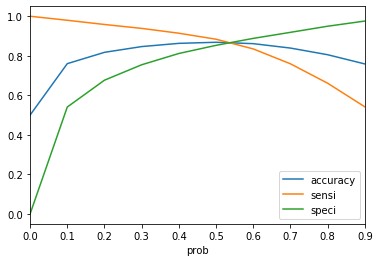

In [62]:
# Let's create columns with different probability cutoffs 
numbers = [float(x)/10 for x in range(10)]
for i in numbers:
    y_train_pred_final[i]= y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > i else 0)

# Now let's calculate accuracy sensitivity and specificity for various probability cutoffs.
cutoff_df = pd.DataFrame( columns = ['prob','accuracy','sensi','speci'])
from sklearn.metrics import confusion_matrix

# TP = confusion[1,1] # true positive 
# TN = confusion[0,0] # true negatives
# FP = confusion[0,1] # false positives
# FN = confusion[1,0] # false negatives

num = [0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9]
for i in num:
    cm1 = metrics.confusion_matrix(y_train_pred_final.Churn, y_train_pred_final[i] )
    total1=sum(sum(cm1))
    accuracy = (cm1[0,0]+cm1[1,1])/total1
    
    speci = cm1[0,0]/(cm1[0,0]+cm1[0,1])
    sensi = cm1[1,1]/(cm1[1,0]+cm1[1,1])
    cutoff_df.loc[i] =[ i ,accuracy,sensi,speci]

# Let's plot accuracy sensitivity and specificity for various probabilities.
cutoff_df.plot.line(x='prob', y=['accuracy','sensi','speci'])
plt.show()

- Using the sensitivity, specificity and accuracy plot the optimal cutoff comes out to 0.5

In [63]:
print(cutoff_df)

     prob  accuracy     sensi     speci
0.0   0.0  0.500000  1.000000  0.000000
0.1   0.1  0.760159  0.979631  0.540686
0.2   0.2  0.817430  0.958329  0.676532
0.3   0.3  0.846533  0.938530  0.754535
0.4   0.4  0.862885  0.914118  0.811651
0.5   0.5  0.868275  0.883746  0.852804
0.6   0.6  0.861356  0.834664  0.888048
0.7   0.7  0.838965  0.759303  0.918628
0.8   0.8  0.805302  0.661086  0.949518
0.9   0.9  0.758630  0.541567  0.975692


In [64]:
y_train_pred_final.head()

,Churn,Churn_Prob,predicted,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9
0,0,0.018273,0,1,0,0,0,0,0,0,0,0,0
1,0,0.052374,0,1,0,0,0,0,0,0,0,0,0
2,0,0.120737,0,1,1,0,0,0,0,0,0,0,0
3,1,0.915927,1,1,1,1,1,1,1,1,1,1,1
4,0,0.541409,1,1,1,1,1,1,1,0,0,0,0


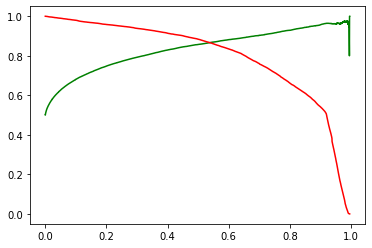

In [65]:
from sklearn.metrics import precision_recall_curve

p, r, thresholds = precision_recall_curve(y_train_pred_final.Churn, y_train_pred_final.Churn_Prob)

plt.plot(thresholds, p[:-1], "g-")
plt.plot(thresholds, r[:-1], "r-")
plt.show()

- From the Precision- Recall curve, 0.5 is the optimum point to take as a cutoff probability

In [66]:
# Using optimal cutoff point to predict the churn
y_train_pred_final['final_predicted'] = y_train_pred_final.Churn_Prob.map( lambda x: 1 if x > 0.5 else 0)
y_train_pred_final.head()

,Churn,Churn_Prob,predicted,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,final_predicted
0,0,0.018273,0,1,0,0,0,0,0,0,0,0,0,0
1,0,0.052374,0,1,0,0,0,0,0,0,0,0,0,0
2,0,0.120737,0,1,1,0,0,0,0,0,0,0,0,0
3,1,0.915927,1,1,1,1,1,1,1,1,1,1,1,1
4,0,0.541409,1,1,1,1,1,1,1,0,0,0,0,1


In [67]:
confusion = metrics.confusion_matrix(y_train_pred_final.Churn, y_train_pred_final.final_predicted )
print(confusion)

# Let's check the overall accuracy.
print(classification_report(y_train_pred_final.Churn, y_train_pred_final.final_predicted))

[[16454  2840]
 [ 2243 17051]]
              precision    recall  f1-score   support

           0       0.88      0.85      0.87     19294
           1       0.86      0.88      0.87     19294

    accuracy                           0.87     38588
   macro avg       0.87      0.87      0.87     38588
weighted avg       0.87      0.87      0.87     38588



In [68]:
# Making predictions on test set

X_test_sm = sm.add_constant(X_test[X_train_res[col].columns])

# Making predictions on the test set
y_test_pred = res.predict(X_test_sm)
y_pred_1 = pd.DataFrame(y_test_pred)

y_test_df = pd.DataFrame(y_test)
y_pred_final = pd.concat([y_test_df, y_pred_1],axis=1)

# Renaming the column 
y_pred_final= y_pred_final.rename(columns={ 0 : 'Churn_Prob'})
y_pred_final['final_predicted'] = y_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)
y_pred_final.head()

,churn,Churn_Prob,final_predicted
20237,0,0.065229,0
8326,0,0.110613,0
72124,0,0.037803,0
65380,0,0.073407,0
42655,0,0.015174,0


In [69]:
confusion = metrics.confusion_matrix(y_pred_final.churn, y_pred_final.final_predicted)
print(confusion)

# Let's check the overall accuracy.
print(classification_report(y_pred_final.churn, y_pred_final.final_predicted))

[[7054 1224]
 [ 199  523]]
              precision    recall  f1-score   support

           0       0.97      0.85      0.91      8278
           1       0.30      0.72      0.42       722

    accuracy                           0.84      9000
   macro avg       0.64      0.79      0.67      9000
weighted avg       0.92      0.84      0.87      9000



**The recall score using the Logisitic Regression model is ~72.4%**

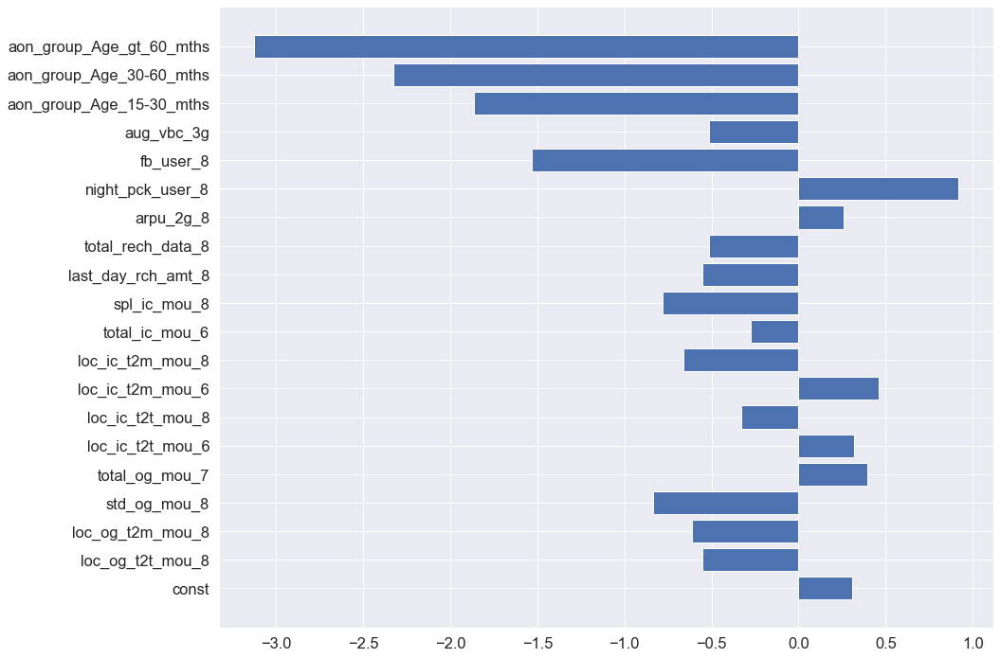

In [70]:
# Looking at the feature importance based on Logisitic Regression results
importance = res.params

sns.set(font_scale=1.5)
plt.figure(figsize=(15,10))
plt.barh( range(len(importance)), importance)
plt.yticks(range(len(importance)),X_test_sm.columns)
#plt.xlabel('x-axis', fontsize=40)
plt.tight_layout()
plt.show()

**Based on our interpretable model, the important churn indicators are-**
- Age on network
- Facebook/ social media uasge in the month of August ('action' phase)
- Volume based cost in August ('action' phase)
- Night pack user in August ('action' phase)
- Average revenue per user in August ('action' phase)
- Recharge amount/data in August ('action' phase)
- STD/ local outgoing minutes of usage in August ('action' phase)
- Local outgoing/incoming calls and minutes of usage in August  ('action' phase)
- Incoming call minutes of usage in June ('good' phase)
- Outgoing call minutes of usage in July ('good' phase)

**Recommendations to the company**
> Most of the important churn indicators are from the month of August, which is the 'action' phase in customer lifecycle. Hence it is important to take corrective measures in this 'action' phase to stop the customers from churning. Based on the above indicators, these measures could be--
1. Provide discounts/ offers to the high value customers in the 'action' phase
2. Keep an eye on the competitor's offer/schemes and roll out similar offers/schemes, if needed
3. Take customer feedback in the 'action phase' and improve the service quality for better customer satisfaction
4. Provide bundle packages to the high value customers, for eg. provide free additional calling minutes to the customers if they have consumed more than x Gb of data in a month  
5. Provide complimentary subscription to different tv/movie streaming platforms like netflix/primevideo to the high value customers in the 'action' phase

### High Performance Model (with PCA)

#### PCA

In [71]:
from sklearn.decomposition import PCA
pca = PCA( random_state=100)

#Doing the PCA on the train data
pca.fit(X_train_res)

PCA(random_state=100)

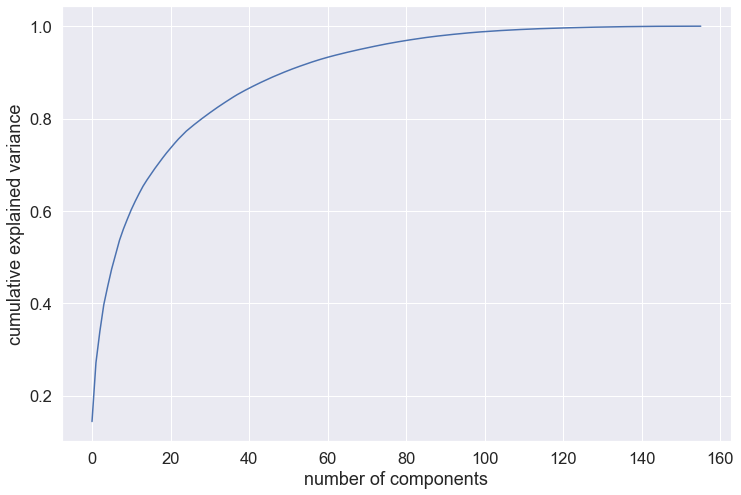

In [72]:
#Making the screeplot - plotting the cumulative variance against the number of components
%matplotlib inline
fig = plt.figure(figsize = (12,8))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
plt.show()

~90% of the variance is explained using 50 components, hence selecting 50 components for modelling

In [73]:
pca = PCA(n_components=50,random_state=100)
#Scale and transform data to get Principal Components

X_train_reduced = pca.fit_transform(X_train_res)
X_test_reduced = pca.transform(X_test)

In [74]:
X_train_reduced.shape

(38588, 50)

In [75]:
list_pca=[]

for i in range(1,51,1):
    list_pca.append('PC'+str(i))

In [76]:
list_pca

['PC1',
 'PC2',
 'PC3',
 'PC4',
 'PC5',
 'PC6',
 'PC7',
 'PC8',
 'PC9',
 'PC10',
 'PC11',
 'PC12',
 'PC13',
 'PC14',
 'PC15',
 'PC16',
 'PC17',
 'PC18',
 'PC19',
 'PC20',
 'PC21',
 'PC22',
 'PC23',
 'PC24',
 'PC25',
 'PC26',
 'PC27',
 'PC28',
 'PC29',
 'PC30',
 'PC31',
 'PC32',
 'PC33',
 'PC34',
 'PC35',
 'PC36',
 'PC37',
 'PC38',
 'PC39',
 'PC40',
 'PC41',
 'PC42',
 'PC43',
 'PC44',
 'PC45',
 'PC46',
 'PC47',
 'PC48',
 'PC49',
 'PC50']

In [77]:
df = pd.DataFrame(X_train_reduced, columns=list_pca)
df.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20,PC21,PC22,PC23,PC24,PC25,PC26,PC27,PC28,PC29,PC30,PC31,PC32,PC33,PC34,PC35,PC36,PC37,PC38,PC39,PC40,PC41,PC42,PC43,PC44,PC45,PC46,PC47,PC48,PC49,PC50
0,-1.962669,2.755611,-3.070743,-1.492561,-1.498159,0.076189,1.385831,0.401641,-1.802304,-0.070556,3.895818,-0.671198,-0.376700,2.637112,0.417606,0.549479,2.671077,-0.347344,-0.424594,0.959576,1.670969,2.800970,-2.495572,2.493018,1.372158,-0.347609,-0.007910,-0.105270,-1.123035,2.057611,2.027208,-0.279941,0.182880,0.106350,-2.238032,-0.352071,0.118983,0.280166,-0.025224,0.174138,-0.198059,0.450031,-0.317690,0.689686,0.334558,-0.142640,-0.509524,-0.141882,-0.090673,-0.130470
1,3.101811,1.141236,-1.622927,-1.247623,-0.328922,-2.456320,-1.590439,-0.402212,-0.623201,0.062351,0.520103,-1.259390,-2.281858,-0.430984,-2.132351,-1.104894,0.422621,-0.545501,-0.492642,0.254526,-0.351063,-1.592254,1.161644,0.472697,0.234781,0.653663,-1.128455,-1.027515,-0.553213,-0.076985,-0.367104,1.130325,0.672797,0.522502,0.406585,0.298190,-0.976329,0.280300,0.679496,-0.002682,0.991529,0.117900,0.629742,2.467825,0.590351,-1.340509,-0.147056,0.322423,0.738034,-0.470038
2,-7.606624,7.499478,7.430090,-1.708286,1.042947,-2.049354,-0.534946,-0.612521,-0.893651,-0.385317,-0.037635,1.187183,-2.449944,-0.031285,-1.091351,-1.178695,-1.946586,0.652089,-1.642122,-0.703500,-0.421349,-0.223771,1.083557,-0.326761,1.317736,0.789175,0.034718,-1.068992,-0.214644,-0.333748,1.495265,0.329059,0.892323,0.775949,-1.045049,-0.817073,0.250929,0.427866,0.256457,-0.125039,0.178437,0.031949,-0.016465,-0.043852,-0.374116,-0.174566,-0.367780,0.059495,-0.913120,0.137582
3,-0.309316,-3.382000,2.085367,-2.885758,-5.493647,3.622854,-6.161635,-0.615394,-0.881100,-0.403193,-1.188386,1.159973,0.991326,-0.283556,1.063284,0.027391,-0.294873,0.171144,-0.306465,-0.116021,0.009014,0.087542,-0.327780,-0.235805,0.413293,-0.336098,0.652666,-0.358015,-0.237612,-0.559736,0.177616,0.248644,0.219834,0.048355,0.000153,-0.266099,-0.099256,-0.053898,0.070210,0.137964,-0.290655,0.077797,-0.280047,-0.400102,-0.141756,0.049271,-0.085864,-0.019446,-0.364551,0.261713
4,6.592054,-2.548765,2.678753,2.283349,1.387340,-3.713225,-0.651504,3.077840,-1.254116,-0.237378,0.130981,1.039628,0.166046,0.027980,0.357156,0.943021,-0.184503,1.768631,0.689978,-0.405972,0.040191,-0.592765,-1.718037,0.072807,1.362039,-0.538327,-0.854381,-0.295491,-0.210726,-1.054893,1.067574,0.699167,0.207723,-0.441384,-0.137520,1.454023,-0.204954,-0.464381,-0.161837,0.550198,0.524878,-0.656208,0.436392,-0.491169,0.322772,-0.128604,-0.203443,-0.391146,0.245952,-0.695922


In [78]:
df_train = pd.concat([df,pd.DataFrame(data=y_train_res, columns=["churn"])], axis=1)

In [79]:
df_train.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20,PC21,PC22,PC23,PC24,PC25,PC26,PC27,PC28,PC29,PC30,PC31,PC32,PC33,PC34,PC35,PC36,PC37,PC38,PC39,PC40,PC41,PC42,PC43,PC44,PC45,PC46,PC47,PC48,PC49,PC50,churn
0,-1.962669,2.755611,-3.070743,-1.492561,-1.498159,0.076189,1.385831,0.401641,-1.802304,-0.070556,3.895818,-0.671198,-0.376700,2.637112,0.417606,0.549479,2.671077,-0.347344,-0.424594,0.959576,1.670969,2.800970,-2.495572,2.493018,1.372158,-0.347609,-0.007910,-0.105270,-1.123035,2.057611,2.027208,-0.279941,0.182880,0.106350,-2.238032,-0.352071,0.118983,0.280166,-0.025224,0.174138,-0.198059,0.450031,-0.317690,0.689686,0.334558,-0.142640,-0.509524,-0.141882,-0.090673,-0.130470,0
1,3.101811,1.141236,-1.622927,-1.247623,-0.328922,-2.456320,-1.590439,-0.402212,-0.623201,0.062351,0.520103,-1.259390,-2.281858,-0.430984,-2.132351,-1.104894,0.422621,-0.545501,-0.492642,0.254526,-0.351063,-1.592254,1.161644,0.472697,0.234781,0.653663,-1.128455,-1.027515,-0.553213,-0.076985,-0.367104,1.130325,0.672797,0.522502,0.406585,0.298190,-0.976329,0.280300,0.679496,-0.002682,0.991529,0.117900,0.629742,2.467825,0.590351,-1.340509,-0.147056,0.322423,0.738034,-0.470038,0
2,-7.606624,7.499478,7.430090,-1.708286,1.042947,-2.049354,-0.534946,-0.612521,-0.893651,-0.385317,-0.037635,1.187183,-2.449944,-0.031285,-1.091351,-1.178695,-1.946586,0.652089,-1.642122,-0.703500,-0.421349,-0.223771,1.083557,-0.326761,1.317736,0.789175,0.034718,-1.068992,-0.214644,-0.333748,1.495265,0.329059,0.892323,0.775949,-1.045049,-0.817073,0.250929,0.427866,0.256457,-0.125039,0.178437,0.031949,-0.016465,-0.043852,-0.374116,-0.174566,-0.367780,0.059495,-0.913120,0.137582,0
3,-0.309316,-3.382000,2.085367,-2.885758,-5.493647,3.622854,-6.161635,-0.615394,-0.881100,-0.403193,-1.188386,1.159973,0.991326,-0.283556,1.063284,0.027391,-0.294873,0.171144,-0.306465,-0.116021,0.009014,0.087542,-0.327780,-0.235805,0.413293,-0.336098,0.652666,-0.358015,-0.237612,-0.559736,0.177616,0.248644,0.219834,0.048355,0.000153,-0.266099,-0.099256,-0.053898,0.070210,0.137964,-0.290655,0.077797,-0.280047,-0.400102,-0.141756,0.049271,-0.085864,-0.019446,-0.364551,0.261713,1
4,6.592054,-2.548765,2.678753,2.283349,1.387340,-3.713225,-0.651504,3.077840,-1.254116,-0.237378,0.130981,1.039628,0.166046,0.027980,0.357156,0.943021,-0.184503,1.768631,0.689978,-0.405972,0.040191,-0.592765,-1.718037,0.072807,1.362039,-0.538327,-0.854381,-0.295491,-0.210726,-1.054893,1.067574,0.699167,0.207723,-0.441384,-0.137520,1.454023,-0.204954,-0.464381,-0.161837,0.550198,0.524878,-0.656208,0.436392,-0.491169,0.322772,-0.128604,-0.203443,-0.391146,0.245952,-0.695922,0


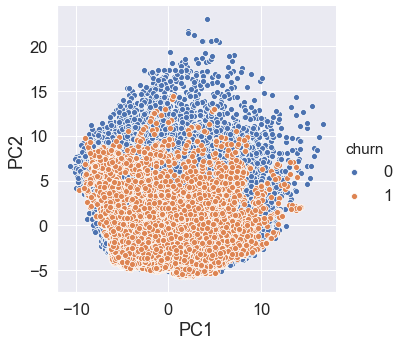

In [80]:
# Visualizing the two most important principal components

sns.pairplot(data=df_train, x_vars=["PC1"], y_vars=["PC2"], hue = "churn", size=5)

In [81]:
df_1 = pd.DataFrame(X_test_reduced, columns=list_pca)
df_test = pd.concat([df_1,pd.DataFrame(data=y_test, columns=["churn"]).reset_index(drop=True)],axis=1)
df_test.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20,PC21,PC22,PC23,PC24,PC25,PC26,PC27,PC28,PC29,PC30,PC31,PC32,PC33,PC34,PC35,PC36,PC37,PC38,PC39,PC40,PC41,PC42,PC43,PC44,PC45,PC46,PC47,PC48,PC49,PC50,churn
0,-5.578960,-2.079488,-3.178818,7.444530,1.099776,2.051658,-0.537930,0.533437,-0.686742,0.568476,0.407827,0.550199,1.073070,2.142329,-0.668031,-0.101261,-0.244477,-2.039629,-0.263798,-3.079226,0.005647,-3.190255,0.885757,1.330667,-0.198076,-0.217396,-1.163866,-0.752849,1.062744,0.917512,0.533148,0.923122,0.497921,-0.179418,-0.517194,-0.905372,0.134877,0.154448,-0.032575,0.081354,-0.155170,-0.140038,0.061954,0.074624,-0.442336,-0.079737,-0.704229,0.370788,0.121258,-0.161792,0
1,2.120732,5.895717,0.593403,-0.332039,0.639752,-5.144172,-2.884839,2.538438,-0.462577,-0.911426,-1.366068,0.727223,-1.106332,0.795852,-3.275400,-3.573894,3.363593,-0.814601,0.439642,-2.877550,1.024212,1.960975,-1.185206,-0.272447,-2.028020,-1.064392,-1.107878,-0.162659,1.306367,0.502681,-0.739153,2.196192,1.916674,0.368319,-0.044632,0.222787,2.575213,-0.002405,-0.560649,0.149717,-0.763449,-0.250505,0.022793,0.770561,1.764932,0.112457,0.143217,-0.505993,-0.223179,-0.636481,0
2,5.247392,5.071676,-7.524918,-0.656820,0.784509,-1.730614,-0.707667,0.763007,0.764336,-2.203932,-1.737148,2.108856,3.860045,1.330979,-0.861591,-1.278639,0.835762,-0.791309,0.094265,-2.812047,-1.197275,-0.480042,-1.379276,2.694487,3.719313,1.007529,0.317959,0.553556,0.648991,1.262982,-0.254942,-1.077098,-0.814199,-1.931941,0.797645,-2.428964,1.516294,0.710190,0.185610,-0.232257,0.033217,-0.299189,-0.232527,0.089700,-0.367690,-0.114709,-0.383690,-0.090364,0.150967,0.435377,0
3,-2.040069,-0.790581,2.488525,-0.107487,-1.226784,-0.390204,0.987379,2.931983,-2.186847,-1.546301,-1.265387,1.751178,-0.397002,-0.035339,-0.314828,-0.940267,-0.603555,-0.934679,-0.281532,1.070133,-0.473286,0.120591,-0.468301,-0.044534,-0.620385,-0.140453,0.051917,0.569842,0.884701,-0.169849,-0.535784,-0.988489,0.384877,0.487375,0.578383,0.739496,-1.079266,1.399278,1.322337,1.044706,0.318391,-1.600787,0.607600,0.049340,-0.348519,-2.128341,1.284664,-0.614951,-0.996833,1.017576,0
4,-5.942807,4.097821,3.227886,0.537894,-1.393972,-1.716256,0.569816,-0.541347,1.879488,-1.070167,0.225284,2.230791,-1.934440,-0.037096,-0.513504,-0.473142,-0.687215,0.140392,0.412996,0.181694,-0.403591,0.612152,-0.183313,0.552465,-0.241711,-0.549578,-0.744552,-0.733592,-0.095494,0.132961,-0.920594,-0.283224,-0.644306,0.150766,1.657702,0.713107,-1.119571,-0.169115,0.391704,0.795227,-0.252423,-0.244235,0.291520,-0.122201,-0.977240,-1.307875,1.180205,-0.067875,-0.863643,1.356246,0


### 1st Model- Random Forest Classifier

In [82]:
# Putting feature variable to X
X_train_pca = df_train.drop('churn',axis=1)

# Putting response variable to y
y_train_pca = df_train['churn']

In [83]:
# Putting feature variable to X
X_test_pca = df_test.drop('churn',axis=1)

# Putting response variable to y
y_test_pca = df_test['churn']

In [149]:
# Importing random forest classifier from sklearn library
from sklearn.ensemble import RandomForestClassifier

# Running the random forest with default parameters.
rfc = RandomForestClassifier()

In [150]:
# fit
rfc.fit(X_train_pca,y_train_pca)

RandomForestClassifier()

In [161]:
# Making predictions
predictions = rfc.predict(X_test_pca)

# Importing classification report and confusion matrix from sklearn metrics
from sklearn.metrics import classification_report,confusion_matrix, accuracy_score

# Let's check the report of our default model
print(classification_report(y_test_pca,predictions))

# Printing confusion matrix
print(confusion_matrix(y_test,predictions))

print(accuracy_score(y_test,predictions))

              precision    recall  f1-score   support

           0       0.96      0.95      0.95      8278
           1       0.48      0.51      0.49       722

    accuracy                           0.92      9000
   macro avg       0.72      0.73      0.72      9000
weighted avg       0.92      0.92      0.92      9000

[[7880  398]
 [ 355  367]]
0.9163333333333333


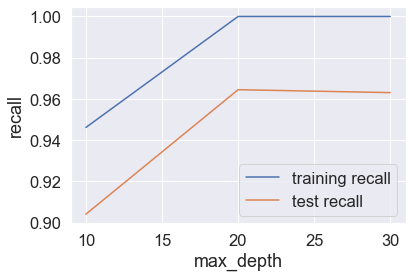

In [165]:
# GridSearchCV to find optimal max_depth based on recall score
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV

# specify number of folds for k-fold CV
n_folds = 3

# parameters to build the model on
parameters = {'max_depth': range(10, 40, 10)}

# instantiate the model
rf = RandomForestClassifier()

# fit tree on training data
rf = GridSearchCV(rf, parameters, cv=n_folds,scoring="recall", return_train_score=True)
rf.fit(X_train_pca, y_train_pca)

scores = rf.cv_results_

# plotting recall with max_depth
plt.figure()
plt.plot(scores["param_max_depth"], 
         scores["mean_train_score"], 
         label="training recall")
plt.plot(scores["param_max_depth"], 
         scores["mean_test_score"], 
         label="test recall")
plt.xlabel("max_depth")
plt.ylabel("recall")
plt.legend()
plt.show()

Based on the above plot max_depth should be in the range 10-15

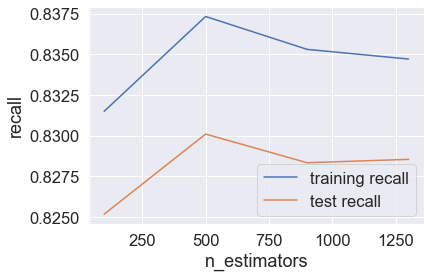

In [167]:
# GridSearchCV to find optimal n_estimators based on recall score

# specify number of folds for k-fold CV
n_folds = 3

# parameters to build the model on
parameters = {'n_estimators': range(100, 1500, 400)}

# instantiate the model (note we are specifying a max_depth)
rf = RandomForestClassifier(max_depth=4)


# fit tree on training data
rf = GridSearchCV(rf, parameters,cv=n_folds, scoring="recall",return_train_score=True)
rf.fit(X_train_pca, y_train_pca)

scores = rf.cv_results_

# plotting recall with n_estimators
plt.figure()
plt.plot(scores["param_n_estimators"], 
         scores["mean_train_score"], 
         label="training recall")
plt.plot(scores["param_n_estimators"], 
         scores["mean_test_score"], 
         label="test recall")
plt.xlabel("n_estimators")
plt.ylabel("recall")
plt.legend()
plt.show()

Based on the above plot n_estimators should be in the range 250-500

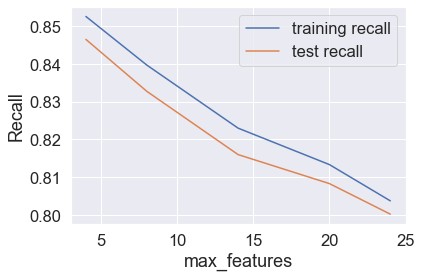

In [169]:
# GridSearchCV to find optimal max_features based on recall score

# specify number of folds for k-fold CV
n_folds = 3

# parameters to build the model on
parameters = {'max_features': [4, 8, 14, 20, 24]}

# instantiate the model (note we are specifying a max_depth)
rf = RandomForestClassifier(max_depth=4)


# fit tree on training data
rf = GridSearchCV(rf, parameters,cv=n_folds, scoring="recall",return_train_score=True)
rf.fit(X_train_pca, y_train_pca)

scores = rf.cv_results_

# plotting recall with max_features
plt.figure()
plt.plot(scores["param_max_features"], 
         scores["mean_train_score"], 
         label="training recall")
plt.plot(scores["param_max_features"], 
         scores["mean_test_score"], 
         label="test recall")
plt.xlabel("max_features")
plt.ylabel("Recall")
plt.legend()
plt.show()

Based on the above plot, max_features should be 5 or 10

In [170]:
# GridSearchCV to find optimal min_samples_leaf based on recall score

# specify number of folds for k-fold CV
n_folds = 3

# parameters to build the model on
parameters = {'min_samples_leaf': range(100, 400, 50)}

# instantiate the model (note we are specifying a max_depth)
rf = RandomForestClassifier(max_depth=4)


# fit tree on training data
rf = GridSearchCV(rf, parameters,cv=n_folds, scoring="recall",return_train_score=True)
rf.fit(X_train_pca, y_train_pca)

KeyError: 'param_min_samples_split'

<Figure size 432x288 with 0 Axes>

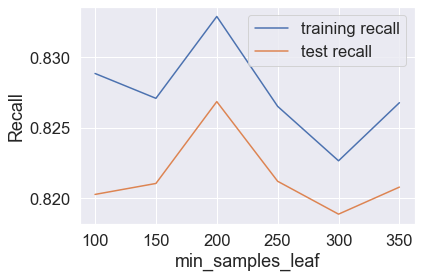

In [172]:
scores = rf.cv_results_

# plotting recall with min_samples_leaf
plt.figure()
plt.plot(scores["param_min_samples_leaf"], 
         scores["mean_train_score"], 
         label="training recall")
plt.plot(scores["param_min_samples_leaf"], 
         scores["mean_test_score"], 
         label="test recall")
plt.xlabel("min_samples_leaf")
plt.ylabel("Recall")
plt.legend()
plt.show()

Based on the above plot, min_samples_leaf should be in the range 100-400

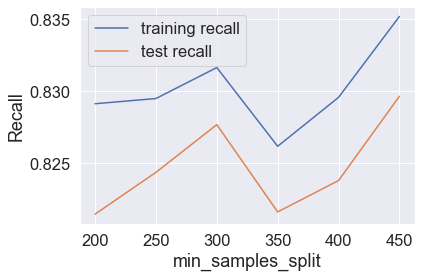

In [173]:
# GridSearchCV to find optimal min_samples_split based on recall score

# specify number of folds for k-fold CV
n_folds = 3

# parameters to build the model on
parameters = {'min_samples_split': range(200, 500, 50)}

# instantiate the model (note we are specifying a max_depth)
rf = RandomForestClassifier(max_depth=4)


# fit tree on training data
rf = GridSearchCV(rf, parameters,cv=n_folds, scoring="recall",return_train_score=True)
rf.fit(X_train_pca, y_train_pca)

scores = rf.cv_results_

# plotting recall with max_features
plt.figure()
plt.plot(scores["param_min_samples_split"], 
         scores["mean_train_score"], 
         label="training recall")
plt.plot(scores["param_min_samples_split"], 
         scores["mean_test_score"], 
         label="test recall")
plt.xlabel("min_samples_split")
plt.ylabel("Recall")
plt.legend()
plt.show()

Based on the above plot, min_samples_split should be in the range 200-500

#### We can now find the optimal hyperparameters using GridSearchCV.

In [174]:
# Create the parameter grid based on the results of random search 
param_grid = {
    'max_depth': [10,15,20],
    'min_samples_leaf': range(100, 400, 200),
    'min_samples_split': range(200, 500, 200),
    'n_estimators': [250,350,500], 
    'max_features': [5, 10]
}
# Create a based model
rf = RandomForestClassifier()
# Instantiate the grid search model
grid_search = GridSearchCV(estimator = rf, param_grid = param_grid, cv = 3, n_jobs = -1,verbose = 1)

In [175]:
# Fit the grid search to the data
grid_search.fit(X_train_pca, y_train_pca)

Fitting 3 folds for each of 72 candidates, totalling 216 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed: 27.1min
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed: 116.5min
[Parallel(n_jobs=-1)]: Done 216 out of 216 | elapsed: 126.8min finished


GridSearchCV(cv=3, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'max_depth': [10, 15, 20], 'max_features': [5, 10],
                         'min_samples_leaf': range(100, 400, 200),
                         'min_samples_split': range(200, 500, 200),
                         'n_estimators': [250, 350, 500]},
             verbose=1)

In [177]:
# printing the optimal accuracy score and hyperparameters
print('We can get recall of',grid_search.best_score_,'using',grid_search.best_params_)

We can get recall of 0.8626516752249954 using {'max_depth': 20, 'max_features': 5, 'min_samples_leaf': 100, 'min_samples_split': 200, 'n_estimators': 500}


**Fitting the final model with the best parameters obtained from grid search.**

In [178]:
# model with the best hyperparameters
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(bootstrap=True,
                             max_depth=20,
                             min_samples_leaf=100, 
                             min_samples_split=200,
                             max_features=5,
                             n_estimators=500)

In [179]:
# fit
rfc.fit(X_train_pca,y_train_pca)

RandomForestClassifier(max_depth=20, max_features=5, min_samples_leaf=100,
                       min_samples_split=200, n_estimators=500)

In [180]:
# predict
predictions = rfc.predict(X_test_pca)

In [181]:
# evaluation metrics
from sklearn.metrics import classification_report,confusion_matrix

print(classification_report(y_test_pca,predictions))

print(confusion_matrix(y_test_pca,predictions))

              precision    recall  f1-score   support

           0       0.97      0.90      0.93      8278
           1       0.36      0.69      0.48       722

    accuracy                           0.88      9000
   macro avg       0.67      0.79      0.70      9000
weighted avg       0.92      0.88      0.89      9000

[[7409  869]
 [ 223  499]]


**The recall score for test using Random Forest Classifier is ~70%**

### 2nd Model- Adaboost (Adaptive Boosting) Classifier

In [86]:
# Adaboost classifier with max 600 decision trees of depth=2
# learning_rate/shrinkage=1.5

# base estimator
tree = DecisionTreeClassifier(max_depth=2)

# adaboost with the tree as base estimator
adaboost_model_1 = AdaBoostClassifier(base_estimator=tree,n_estimators=600,learning_rate=1.5,algorithm="SAMME")

In [87]:
# fit
adaboost_model_1.fit(X_train_pca, y_train_pca)

AdaBoostClassifier(algorithm='SAMME',
                   base_estimator=DecisionTreeClassifier(max_depth=2),
                   learning_rate=1.5, n_estimators=600)

In [88]:
# predictions
# the second column represents the probability of churn
predictions = adaboost_model_1.predict_proba(X_test_pca)
predictions[:10]

array([[0.51165141, 0.48834859],
       [0.5287135 , 0.4712865 ],
       [0.52493211, 0.47506789],
       [0.52222163, 0.47777837],
       [0.51828718, 0.48171282],
       [0.52194012, 0.47805988],
       [0.52754148, 0.47245852],
       [0.51069289, 0.48930711],
       [0.52254483, 0.47745517],
       [0.51208669, 0.48791331]])

In [92]:
# ROC AUC score
metrics.roc_auc_score(y_test_pca, predictions[:,1])

0.861088095870709

In [93]:
# Adaboost hyperparameter tuning based on recall score

# parameter grid
param_grid = {"base_estimator__max_depth" : [2, 5], "n_estimators": [200, 400, 600]}

# base estimator
tree = DecisionTreeClassifier()

# adaboost with the tree as base estimator
# learning rate is set to 0.6
ABC = AdaBoostClassifier(base_estimator=tree,learning_rate=0.6,algorithm="SAMME")

# run grid search 
folds = 3
grid_search_ABC = GridSearchCV(ABC,cv=folds,param_grid=param_grid,scoring = 'recall',return_train_score=True,verbose=1)

In [94]:
# fit 
grid_search_ABC.fit(X_train_pca, y_train_pca)

Fitting 3 folds for each of 6 candidates, totalling 18 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  18 out of  18 | elapsed: 127.8min finished


GridSearchCV(cv=3,
             estimator=AdaBoostClassifier(algorithm='SAMME',
                                          base_estimator=DecisionTreeClassifier(),
                                          learning_rate=0.6),
             param_grid={'base_estimator__max_depth': [2, 5],
                         'n_estimators': [200, 400, 600]},
             return_train_score=True, scoring='recall', verbose=1)

In [95]:
cv_results = pd.DataFrame(grid_search_ABC.cv_results_)

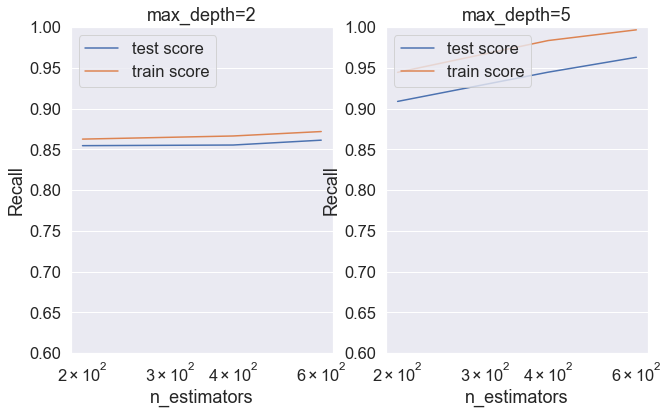

In [96]:
# plotting recall with hyperparameter combinations

plt.figure(figsize=(16,6))
for n, depth in enumerate(param_grid['base_estimator__max_depth']):

    # subplot 1/n
    plt.subplot(1,3, n+1)
    depth_df = cv_results[cv_results['param_base_estimator__max_depth']==depth]

    plt.plot(depth_df["param_n_estimators"], depth_df["mean_test_score"])
    plt.plot(depth_df["param_n_estimators"], depth_df["mean_train_score"])
    plt.xlabel('n_estimators')
    plt.ylabel('Recall')
    plt.title("max_depth={0}".format(depth))
    plt.ylim([0.60, 1])
    plt.legend(['test score', 'train score'], loc='upper left')
    plt.xscale('log')

To avoid overfitting, choosing max_depth=2 and n_estimators=600

In [155]:
# model performance on test data with chosen hyperparameters

# base estimator
tree = DecisionTreeClassifier(max_depth=2)

# adaboost with the tree as base estimator
# learning rate is arbitrarily set, we'll discuss learning_rate below
ABC = AdaBoostClassifier(base_estimator=tree,learning_rate=0.1,n_estimators=600,algorithm="SAMME")

ABC.fit(X_train_pca, y_train_pca)

AdaBoostClassifier(algorithm='SAMME',
                   base_estimator=DecisionTreeClassifier(max_depth=2),
                   learning_rate=0.1, n_estimators=600)

In [156]:
# predict on test data
predictions = ABC.predict(X_test_pca)

print(confusion_matrix(y_test_pca,predictions))

print ("Accuracy : %.4g" % metrics.roc_auc_score(y_test_pca, predictions))
print ("Recall/Sensitivity : %.4g" % metrics.recall_score(y_test_pca, predictions))
print ("AUC Score (Test): %f" % metrics.roc_auc_score(y_test_pca, predictions))

[[6990 1288]
 [ 178  544]]
Accuracy : 0.7989
Recall/Sensitivity : 0.7535
AUC Score (Test): 0.798935


**Using Adaboost classifier model the recall score obtained is 75.35% (best so far)**

### 3rd Model- Gradient Boosting Classifier

In [116]:
# parameter grid
param_grid = {"learning_rate": [0.2, 0.6, 0.9],
              "subsample": [0.3, 0.6, 0.9]
             }

In [118]:
# Gradient Boosting with the tree as base estimator
from sklearn.ensemble import GradientBoostingClassifier

GBC = GradientBoostingClassifier(max_depth=5, n_estimators=200)

In [119]:
# run grid search
folds = 3
grid_search_GBC = GridSearchCV(GBC, 
                               cv = folds,
                               param_grid=param_grid, 
                               scoring = 'recall', 
                               return_train_score=True,                         
                               verbose = 1)

grid_search_GBC.fit(X_train_pca, y_train_pca)

cv_results = pd.DataFrame(grid_search_GBC.cv_results_)

Fitting 3 folds for each of 9 candidates, totalling 27 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  27 out of  27 | elapsed: 53.4min finished


In [121]:
cv_results

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_learning_rate,param_subsample,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,mean_train_score,std_train_score
0,62.720670,3.626482,0.120712,0.017830,0.2,0.3,"{'learning_rate': 0.2, 'subsample': 0.3}",0.931426,0.950560,0.944332,0.942106,0.007968,5,0.987095,0.981263,0.983363,0.983907,0.002412
1,133.737122,2.742252,0.195510,0.105249,0.2,0.6,"{'learning_rate': 0.2, 'subsample': 0.6}",0.947131,0.965019,0.965480,0.959210,0.008543,3,0.996657,0.995491,0.996035,0.996061,0.000477
2,165.290836,3.486302,0.108836,0.012058,0.2,0.9,"{'learning_rate': 0.2, 'subsample': 0.9}",0.954595,0.969683,0.966413,0.963563,0.006481,2,0.997590,0.996501,0.997124,0.997072,0.000446
3,62.022450,4.364529,0.072773,0.007222,0.6,0.3,"{'learning_rate': 0.6, 'subsample': 0.3}",0.874048,0.916822,0.914632,0.901834,0.019668,8,0.940294,0.938890,0.946280,0.941821,0.003205
4,120.443034,11.459680,0.072465,0.007773,0.6,0.6,"{'learning_rate': 0.6, 'subsample': 0.6}",0.916032,0.949316,0.951019,0.938789,0.016107,6,0.986395,0.988338,0.995258,0.989997,0.003804
5,176.632147,7.793288,0.125057,0.012821,0.6,0.9,"{'learning_rate': 0.6, 'subsample': 0.9}",0.949308,0.975746,0.970300,0.965118,0.011398,1,0.999922,1.000000,1.000000,0.999974,0.000037
6,57.822972,2.475702,0.088540,0.014740,0.9,0.3,"{'learning_rate': 0.9, 'subsample': 0.3}",0.852589,0.892102,0.880734,0.875142,0.016609,9,0.923268,0.916109,0.904377,0.914585,0.007787
7,125.986261,9.192786,0.094044,0.025448,0.9,0.6,"{'learning_rate': 0.9, 'subsample': 0.6}",0.907168,0.931592,0.925051,0.921270,0.010323,7,0.989660,0.985228,0.963772,0.979553,0.011305
8,160.248550,1.293048,0.109375,0.022096,0.9,0.9,"{'learning_rate': 0.9, 'subsample': 0.9}",0.950241,0.959733,0.967190,0.959055,0.006936,4,1.000000,0.999767,0.999922,0.999896,0.000097


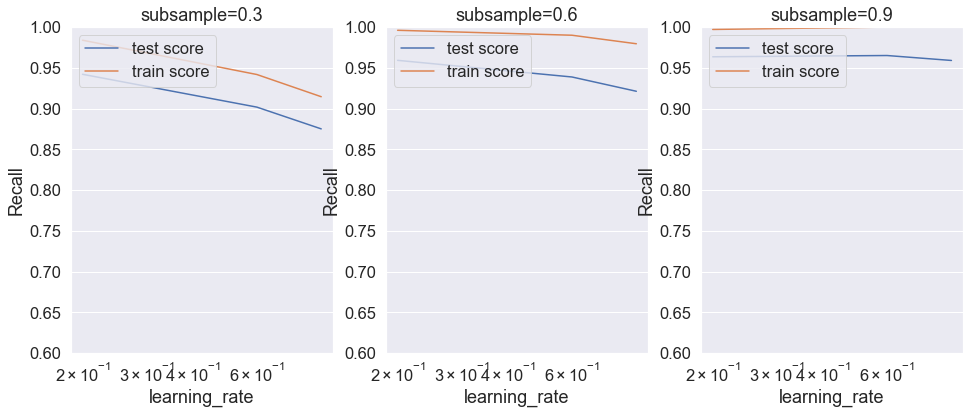

In [120]:
# # plotting
plt.figure(figsize=(16,6))

for n, subsample in enumerate(param_grid['subsample']):

    # subplot 1/n
    plt.subplot(1,len(param_grid['subsample']), n+1)
    df = cv_results[cv_results['param_subsample']==subsample]

    plt.plot(df["param_learning_rate"], df["mean_test_score"])
    plt.plot(df["param_learning_rate"], df["mean_train_score"])
    plt.xlabel('learning_rate')
    plt.ylabel('Recall')
    plt.title("subsample={0}".format(subsample))
    plt.ylim([0.60, 1])
    plt.legend(['test score', 'train score'], loc='upper left')
    plt.xscale('log')

Based on the above plot, subsample=0.6 and learning_rate=0.1 is chosen

In [152]:
# Tunned GradientBoostingClassifier
gbm_final = GradientBoostingClassifier(learning_rate=0.1, n_estimators=600,max_features=2,max_depth=2, min_samples_split=300, min_samples_leaf=200, subsample=0.6, random_state=10)

In [153]:
gbm_final.fit(X_train_pca, y_train_pca)

GradientBoostingClassifier(max_depth=2, max_features=2, min_samples_leaf=200,
                           min_samples_split=300, n_estimators=600,
                           random_state=10, subsample=0.6)

In [158]:
# predictions on Test data
predictions_gbm = gbm_final.predict(X_test_pca)

print(confusion_matrix(y_test_pca,predictions_gbm))

print ("Accuracy : %.4g" % metrics.roc_auc_score(y_test_pca, predictions_gbm))
print ("Recall/Sensitivity : %.4g" % metrics.recall_score(y_test_pca, predictions_gbm))
print ("AUC Score (Train): %f" % metrics.roc_auc_score(y_test_pca, predictions_gbm))

[[7212 1066]
 [ 185  537]]
Accuracy : 0.8075
Recall/Sensitivity : 0.7438
AUC Score (Train): 0.807496


**Using Gradient Boosting Classifier the recall score obtained is 74.38%**

#### Based on the results, we can use the above hyperparameter tuned Adaboost or Gradient Boosting classifier model to accurately predict churn